<a href="https://colab.research.google.com/github/adrak-sleeps/Crop-Disease-Detection-using-Drone/blob/main/Crop_Disease_Detection_using_ResNet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Crop disease detection using ResNet**

## **Downloading the PlantVillage Dataset**

In [1]:
!pip install -q kaggle
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"ansitabehera","key":"eb8e57d47a18c3801e5d07dcb050c9c4"}\r\n\r\n'}

In [2]:
# Downloading the PlantVillage dataset from Kaggle and unzipping it.
%%capture
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d vipoooool/new-plant-diseases-dataset
!unzip /content/new-plant-diseases-dataset.zip

## **Importing necessary libraries**

In [3]:
!pip install torchsummary

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
import os                       # for working with files
import numpy as np              # for numerical computationss
import pandas as pd             # for working with dataframes
import torch                    # Pytorch module 
import matplotlib.pyplot as plt # for plotting informations on graph and images using tensors
import torch.nn as nn           # for creating  neural networks
from torch.utils.data import DataLoader # for dataloaders 
from PIL import Image           # for checking images
import torch.nn.functional as F # for functions for calculating loss
import torchvision.transforms as transforms   # for transforming images into tensors 
from torchvision.utils import make_grid       # for data checking
from torchvision.datasets import ImageFolder  # for working with classes and images
from torchsummary import summary              # for getting the summary of our model

%matplotlib inline

# **Exploratory Data Analysis**

In [5]:
data_dir = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)"
train_dir = data_dir + "/train"
valid_dir = data_dir + "/valid"
diseases = os.listdir(train_dir)

In [6]:
# printing the disease names
print(diseases)

['Peach___healthy', 'Raspberry___healthy', 'Blueberry___healthy', 'Apple___Cedar_apple_rust', 'Tomato___Late_blight', 'Pepper,_bell___healthy', 'Tomato___Leaf_Mold', 'Pepper,_bell___Bacterial_spot', 'Potato___Early_blight', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Corn_(maize)___Northern_Leaf_Blight', 'Tomato___Tomato_mosaic_virus', 'Cherry_(including_sour)___healthy', 'Peach___Bacterial_spot', 'Soybean___healthy', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Grape___Esca_(Black_Measles)', 'Orange___Haunglongbing_(Citrus_greening)', 'Tomato___Target_Spot', 'Tomato___Early_blight', 'Squash___Powdery_mildew', 'Corn_(maize)___Common_rust_', 'Grape___Black_rot', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Tomato___healthy', 'Tomato___Septoria_leaf_spot', 'Apple___Black_rot', 'Potato___healthy', 'Tomato___Bacterial_spot', 'Apple___healthy', 'Grape___healthy', 'Corn_(maize)___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Strawberry___Leaf_scorch', 'Corn_(maize)___Cercospor

In [7]:
print("Total disease and healthy classes are: {}".format(len(diseases)))

Total disease and healthy classes are: 38


In [8]:
plants = []
disease = []
NumberOfDiseases = 0
for plant in diseases:
    if plant.split('___')[0] not in plants:
        plants.append(plant.split('___')[0])
    if plant.split('___')[1] != 'healthy':
        NumberOfDiseases += 1
        disease.append(plant.split('___')[1])

In [9]:
print(f"Unique Diseases are: \n {disease}")

Unique Diseases are: 
 ['Cedar_apple_rust', 'Late_blight', 'Leaf_Mold', 'Bacterial_spot', 'Early_blight', 'Leaf_blight_(Isariopsis_Leaf_Spot)', 'Northern_Leaf_Blight', 'Tomato_mosaic_virus', 'Bacterial_spot', 'Tomato_Yellow_Leaf_Curl_Virus', 'Esca_(Black_Measles)', 'Haunglongbing_(Citrus_greening)', 'Target_Spot', 'Early_blight', 'Powdery_mildew', 'Common_rust_', 'Black_rot', 'Spider_mites Two-spotted_spider_mite', 'Septoria_leaf_spot', 'Black_rot', 'Bacterial_spot', 'Powdery_mildew', 'Leaf_scorch', 'Cercospora_leaf_spot Gray_leaf_spot', 'Apple_scab', 'Late_blight']


In [10]:
print("Number of diseases (excluding healthy): {}".format(len(disease)))

Number of diseases (excluding healthy): 26


In [11]:
# unique plants in the dataset
print(f"Unique Plants are: \n{plants}")

Unique Plants are: 
['Peach', 'Raspberry', 'Blueberry', 'Apple', 'Tomato', 'Pepper,_bell', 'Potato', 'Grape', 'Corn_(maize)', 'Cherry_(including_sour)', 'Soybean', 'Orange', 'Squash', 'Strawberry']


In [12]:
# number of unique plants
print("Number of plants: {}".format(len(plants)))

Number of plants: 14


In [13]:
# Number of images for each disease
nums = {}
for disease in diseases:
    nums[disease] = len(os.listdir(train_dir + '/' + disease))
    
# converting the nums dictionary to pandas dataframe passing index as plant name and number of images as column

img_per_class = pd.DataFrame(nums.values(), index=nums.keys(), columns=["no. of images"])
img_per_class

,no. of images
Peach___healthy,1728
Raspberry___healthy,1781
Blueberry___healthy,1816
Apple___Cedar_apple_rust,1760
Tomato___Late_blight,1851
"Pepper,_bell___healthy",1988
Tomato___Leaf_Mold,1882
"Pepper,_bell___Bacterial_spot",1913
Potato___Early_blight,1939
Grape___Leaf_blight_(Isariopsis_Leaf_Spot),1722


Text(0.5, 1.0, 'Images per each class of plant disease')

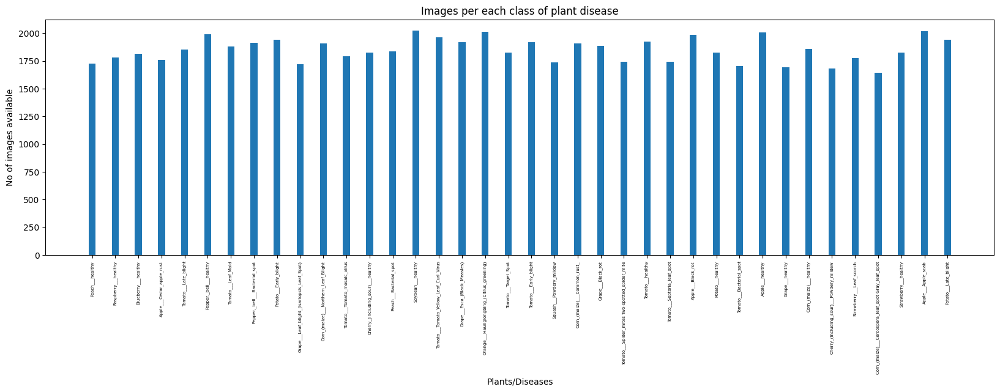

In [14]:
# plotting number of images available for each disease

index = [n for n in range(38)]
plt.figure(figsize=(20, 5))
plt.bar(index, [n for n in nums.values()], width=0.3)
plt.xlabel('Plants/Diseases', fontsize=10)
plt.ylabel('No of images available', fontsize=10)
plt.xticks(index, diseases, fontsize=5, rotation=90)
plt.title('Images per each class of plant disease')

In [15]:
n_train = 0
for value in nums.values():
    n_train += value
print(f"There are {n_train} images for training")

There are 70295 images for training


# **Preparing the data for training**

In [16]:
# datasets for validation and training
train = ImageFolder(train_dir, transform=transforms.ToTensor())
valid = ImageFolder(valid_dir, transform=transforms.ToTensor()) 

In [17]:
# for checking some images from training dataset
def show_image(image, label):
    print("Label :" + train.classes[label] + "(" + str(label) + ")")
    plt.imshow(image.permute(1, 2, 0))

In [18]:
# Setting the seed value
random_seed = 7
torch.manual_seed(random_seed)

In [19]:
# setting the batch size
batch_size = 32

In [20]:
# DataLoaders for training and validation
train_dl = DataLoader(train, batch_size, shuffle=True, num_workers=2, pin_memory=True)
valid_dl = DataLoader(valid, batch_size, num_workers=2, pin_memory=True)

In [21]:
# helper function to show a batch of training instances
def show_batch(data):
    for images, labels in data:
        fig, ax = plt.subplots(figsize=(30, 30))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(images, nrow=8).permute(1, 2, 0))
        break

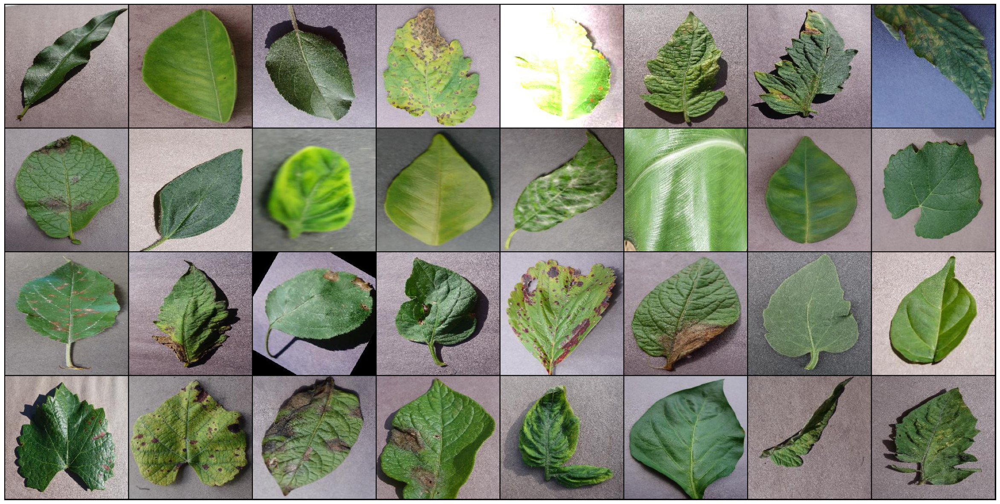

In [22]:
# Images for first batch of training
show_batch(train_dl) 

# **Some helper functions**

In [23]:
# for moving data into GPU (if available)
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available:
        return torch.device("cuda")
    else:
        return torch.device("cpu")

# for moving data to device (CPU or GPU)
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

# for loading in the device (GPU if available else CPU)
class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl:
            yield to_device(b, self.device)
        
    def __len__(self):
        """Number of batches"""
        return len(self.dl)

In [24]:
device = get_default_device()
device

device(type='cuda')

In [25]:
# Moving data into GPU
train_dl = DeviceDataLoader(train_dl, device)
valid_dl = DeviceDataLoader(valid_dl, device)

# **Building the Model**

In [26]:
class SimpleResidualBlock(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=3, kernel_size=3, stride=1, padding=1)
        self.relu1 = nn.ReLU()
        self.conv2 = nn.Conv2d(in_channels=3, out_channels=3, kernel_size=3, stride=1, padding=1)
        self.relu2 = nn.ReLU()
        
    def forward(self, x):
        out = self.conv1(x)
        out = self.relu1(out)
        out = self.conv2(out)
        return self.relu2(out) + x # ReLU can be applied before or after adding the input

In [27]:
# for calculating the accuracy
def accuracy(outputs, labels):
    _, preds = torch.max(outputs, dim=1)
    return torch.tensor(torch.sum(preds == labels).item() / len(preds))


# base class for the model
class ImageClassificationBase(nn.Module):
    
    def training_step(self, batch):
        images, labels = batch
        out = self(images)                  # Generate predictions
        loss = F.cross_entropy(out, labels) # Calculate loss
        return loss
    
    def validation_step(self, batch):
        images, labels = batch
        out = self(images)                   # Generate prediction
        loss = F.cross_entropy(out, labels)  # Calculate loss
        acc = accuracy(out, labels)          # Calculate accuracy
        return {"val_loss": loss.detach(), "val_accuracy": acc}
    
    def validation_epoch_end(self, outputs):
        batch_losses = [x["val_loss"] for x in outputs]
        batch_accuracy = [x["val_accuracy"] for x in outputs]
        epoch_loss = torch.stack(batch_losses).mean()       # Combine loss  
        epoch_accuracy = torch.stack(batch_accuracy).mean()
        return {"val_loss": epoch_loss, "val_accuracy": epoch_accuracy} # Combine accuracies
    
    def epoch_end(self, epoch, result):
        print("Epoch [{}], last_lr: {:.5f}, train_loss: {:.4f}, val_loss: {:.4f}, val_acc: {:.4f}".format(
            epoch, result['lrs'][-1], result['train_loss'], result['val_loss'], result['val_accuracy']))
        

In [28]:
# Architecture for training

# convolution block with BatchNormalization
def ConvBlock(in_channels, out_channels, pool=False):
    layers = [nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
             nn.BatchNorm2d(out_channels),
             nn.ReLU(inplace=True)]
    if pool:
        layers.append(nn.MaxPool2d(4))
    return nn.Sequential(*layers)


# resnet architecture 
class ResNet9(ImageClassificationBase):
    def __init__(self, in_channels, num_diseases):
        super().__init__()
        
        self.conv1 = ConvBlock(in_channels, 64)
        self.conv2 = ConvBlock(64, 128, pool=True) # out_dim : 128 x 64 x 64 
        self.res1 = nn.Sequential(ConvBlock(128, 128), ConvBlock(128, 128))
        
        self.conv3 = ConvBlock(128, 256, pool=True) # out_dim : 256 x 16 x 16
        self.conv4 = ConvBlock(256, 512, pool=True) # out_dim : 512 x 4 x 44
        self.res2 = nn.Sequential(ConvBlock(512, 512), ConvBlock(512, 512))
        
        self.classifier = nn.Sequential(nn.MaxPool2d(4),
                                       nn.Flatten(),
                                       nn.Linear(512, num_diseases))
        
    def forward(self, xb): # xb is the loaded batch
        out = self.conv1(xb)
        out = self.conv2(out)
        out = self.res1(out) + out
        out = self.conv3(out)
        out = self.conv4(out)
        out = self.res2(out) + out
        out = self.classifier(out)
        return out        

In [29]:
# defining the model and moving it to the GPU
model = to_device(ResNet9(3, len(train.classes)), device) 
model
# model = ResNet9(3, len(train.classes))

ResNet9(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  )
  (res1): Sequential(
    (0): Sequential(
      (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=Tr

In [30]:
# getting summary of the model
INPUT_SHAPE = (3, 256, 256)
print(summary(model.cuda(), (INPUT_SHAPE)))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,792
       BatchNorm2d-2         [-1, 64, 256, 256]             128
              ReLU-3         [-1, 64, 256, 256]               0
            Conv2d-4        [-1, 128, 256, 256]          73,856
       BatchNorm2d-5        [-1, 128, 256, 256]             256
              ReLU-6        [-1, 128, 256, 256]               0
         MaxPool2d-7          [-1, 128, 64, 64]               0
            Conv2d-8          [-1, 128, 64, 64]         147,584
       BatchNorm2d-9          [-1, 128, 64, 64]             256
             ReLU-10          [-1, 128, 64, 64]               0
           Conv2d-11          [-1, 128, 64, 64]         147,584
      BatchNorm2d-12          [-1, 128, 64, 64]             256
             ReLU-13          [-1, 128, 64, 64]               0
           Conv2d-14          [-1, 256,

In [31]:
# for training
@torch.no_grad()
def evaluate(model, val_loader):
    model.eval()
    outputs = [model.validation_step(batch) for batch in val_loader]
    return model.validation_epoch_end(outputs)


def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        # return 0.005
        return param_group['lr']
    

def fit_OneCycle(epochs, max_lr, model, train_loader, val_loader, weight_decay=0,
                grad_clip=None, opt_func=torch.optim.SGD):
    torch.cuda.empty_cache()
    history = []
    
    optimizer = opt_func(model.parameters(), max_lr, weight_decay=weight_decay)
    # scheduler for one cycle learniing rate
    sched = torch.optim.lr_scheduler.OneCycleLR(optimizer, max_lr, epochs=epochs, steps_per_epoch=len(train_loader))
    
    
    for epoch in range(epochs):
        # Training
        model.train()
        train_losses = []
        lrs = []
        for batch in train_loader:
            # loss = model.training_step(batch)
            loss = model.training_step(batch)
            train_losses.append(loss)
            loss.backward()
            
            # gradient clipping
            if grad_clip: 
                nn.utils.clip_grad_value_(model.parameters(), grad_clip)
                
            optimizer.step()
            optimizer.zero_grad()
            
            # recording and updating learning rates
            lrs.append(get_lr(optimizer))
            sched.step()
            
    
        # validation
        result = evaluate(model, val_loader)
        result['train_loss'] = torch.stack(train_losses).mean().item()
        result['lrs'] = lrs
        model.epoch_end(epoch, result)
        history.append(result)
        
    return history
    

# **Training the Model**

In [32]:
%%time
history = [evaluate(model, valid_dl)]
history

CPU times: user 47.1 s, sys: 4.22 s, total: 51.3 s
Wall time: 1min 24s


[{'val_loss': tensor(3.6378, device='cuda:0'), 'val_accuracy': tensor(0.0282)}]

In [33]:
epochs = 2
max_lr = 0.01
grad_clip = 0.1
weight_decay = 1e-4
opt_func = torch.optim.Adam

In [34]:
%%time
history += fit_OneCycle(epochs, max_lr, model, train_dl, valid_dl, 
                             grad_clip=grad_clip, 
                             weight_decay=1e-4, 
                             opt_func=opt_func)

Epoch [0], last_lr: 0.00812, train_loss: 0.7509, val_loss: 0.5665, val_acc: 0.8390
Epoch [1], last_lr: 0.00000, train_loss: 0.1266, val_loss: 0.0283, val_acc: 0.9919
CPU times: user 14min 45s, sys: 15min 41s, total: 30min 26s
Wall time: 33min 5s


In [35]:
import torch
torch.save(model, "/content/Model.pth")


# # to load model 
model = torch.load("/content/Model.pth")


## **Crop Disease Detection using the above ResNet model is giving 99.2% accuracy.**

# **Plotting the Results**




In [36]:
def plot_accuracies(history):
    accuracies = [x['val_accuracy'] for x in history]
    plt.plot(accuracies, '-x')
    plt.xlabel('epoch')
    plt.ylabel('accuracy')
    plt.title('Accuracy vs. No. of epochs');


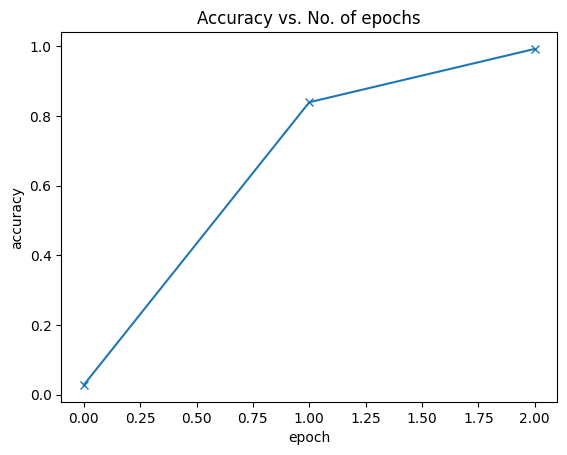

In [37]:
plot_accuracies(history)

## **Testing**

In [38]:
test_dir = "/content/test"
test = ImageFolder(test_dir, transform=transforms.ToTensor())


from PIL import Image
import os, sys
path = ('/content/test/test')

def resize():
    for item in os.listdir(path):
        if os.path.isfile(path+item):
            im = Image.open(path+item)
            f, e = os.path.splitext(path+item)
            imResize = im.resize((256,256), Image.ANTIALIAS)
            imResize.save(f + ' resized.jpg', 'JPG', quality=90)

resize()

In [39]:
test_images = sorted(os.listdir(test_dir + '/test')) # since images in test folder are in alphabetical order
test_images

['AppleCedarRust1.JPG',
 'AppleCedarRust2.JPG',
 'AppleCedarRust3.JPG',
 'AppleCedarRust4.JPG',
 'AppleScab1.JPG',
 'AppleScab2.JPG',
 'AppleScab3.JPG',
 'CornCommonRust1.JPG',
 'CornCommonRust2.JPG',
 'CornCommonRust3.JPG',
 'PotatoEarlyBlight1.JPG',
 'PotatoEarlyBlight2.JPG',
 'PotatoEarlyBlight3.JPG',
 'PotatoEarlyBlight4.JPG',
 'PotatoEarlyBlight5.JPG',
 'PotatoHealthy1.JPG',
 'PotatoHealthy2.JPG',
 'TomatoEarlyBlight1.JPG',
 'TomatoEarlyBlight2.JPG',
 'TomatoEarlyBlight3.JPG',
 'TomatoEarlyBlight4.JPG',
 'TomatoEarlyBlight5.JPG',
 'TomatoEarlyBlight6.JPG',
 'TomatoHealthy1.JPG',
 'TomatoHealthy2.JPG',
 'TomatoHealthy3.JPG',
 'TomatoHealthy4.JPG',
 'TomatoYellowCurlVirus1.JPG',
 'TomatoYellowCurlVirus2.JPG',
 'TomatoYellowCurlVirus3.JPG',
 'TomatoYellowCurlVirus4.JPG',
 'TomatoYellowCurlVirus5.JPG',
 'TomatoYellowCurlVirus6.JPG']

In [40]:
def predict_image(img, model):
    """Converts image to array and return the predicted class
        with highest probability"""
    # Convert to a batch of 1
    xb = to_device(img.unsqueeze(0), device)
    # Get predictions from model
    yb = model(xb)
    # Pick index with highest probability
    _, preds  = torch.max(yb, dim=1)
    # Retrieve the class label

    return train.classes[preds[0].item()]

Label: AppleCedarRust1.JPG , Predicted: Apple___Cedar_apple_rust


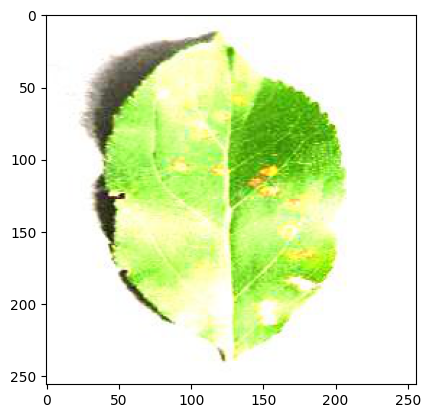

In [41]:
# predicting first image
img, label = test[0]
plt.imshow(img.permute(1, 2, 0))
print('Label:', test_images[0], ', Predicted:', predict_image(img, model))

In [42]:
# getting all predictions (actual label vs predicted)
for i, (img, label) in enumerate(test):
    print('Label:', test_images[i], ', Predicted:', predict_image(img, model))

Label: AppleCedarRust1.JPG , Predicted: Apple___Cedar_apple_rust
Label: AppleCedarRust2.JPG , Predicted: Apple___Cedar_apple_rust
Label: AppleCedarRust3.JPG , Predicted: Apple___Cedar_apple_rust
Label: AppleCedarRust4.JPG , Predicted: Apple___Cedar_apple_rust
Label: AppleScab1.JPG , Predicted: Apple___Apple_scab
Label: AppleScab2.JPG , Predicted: Apple___Apple_scab
Label: AppleScab3.JPG , Predicted: Apple___Apple_scab
Label: CornCommonRust1.JPG , Predicted: Corn_(maize)___Common_rust_
Label: CornCommonRust2.JPG , Predicted: Corn_(maize)___Common_rust_
Label: CornCommonRust3.JPG , Predicted: Corn_(maize)___Common_rust_
Label: PotatoEarlyBlight1.JPG , Predicted: Potato___Early_blight
Label: PotatoEarlyBlight2.JPG , Predicted: Potato___Early_blight
Label: PotatoEarlyBlight3.JPG , Predicted: Potato___Early_blight
Label: PotatoEarlyBlight4.JPG , Predicted: Potato___Early_blight
Label: PotatoEarlyBlight5.JPG , Predicted: Potato___Early_blight
Label: PotatoHealthy1.JPG , Predicted: Potato___h

# **Simulating a drone dataset**

# **Method 1: Modifying the Dataset**

In [43]:
from PIL import Image, ImageFilter
import os, sys
import cv2
path = ("/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train")
new_path = ("/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir")
new_path2 = ("/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir_sharp")

os.mkdir(new_path)
os.mkdir(new_path2)

In [44]:
os.mkdir(new_path + '/train')
os.mkdir(new_path + '/test')

os.mkdir(new_path2 + '/train')
os.mkdir(new_path2 + '/test')

In [45]:
os.listdir(path)

['Peach___healthy',
 'Raspberry___healthy',
 'Blueberry___healthy',
 'Apple___Cedar_apple_rust',
 'Tomato___Late_blight',
 'Pepper,_bell___healthy',
 'Tomato___Leaf_Mold',
 'Pepper,_bell___Bacterial_spot',
 'Potato___Early_blight',
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)',
 'Corn_(maize)___Northern_Leaf_Blight',
 'Tomato___Tomato_mosaic_virus',
 'Cherry_(including_sour)___healthy',
 'Peach___Bacterial_spot',
 'Soybean___healthy',
 'Tomato___Tomato_Yellow_Leaf_Curl_Virus',
 'Grape___Esca_(Black_Measles)',
 'Orange___Haunglongbing_(Citrus_greening)',
 'Tomato___Target_Spot',
 'Tomato___Early_blight',
 'Squash___Powdery_mildew',
 'Corn_(maize)___Common_rust_',
 'Grape___Black_rot',
 'Tomato___Spider_mites Two-spotted_spider_mite',
 'Tomato___healthy',
 'Tomato___Septoria_leaf_spot',
 'Apple___Black_rot',
 'Potato___healthy',
 'Tomato___Bacterial_spot',
 'Apple___healthy',
 'Grape___healthy',
 'Corn_(maize)___healthy',
 'Cherry_(including_sour)___Powdery_mildew',
 'Strawberry___Leaf_s

In [ ]:
for (z1, z2, z3) in os.walk(path):
  print(z1)

In [46]:
import shutil

for(root, dirs, files) in os.walk(path):
  for item in dirs:
    x = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train/" + item
    if os.path.exists(x):
      print(item)
    else:
      os.mkdir(x)

    y = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir_sharp/train/" + item
    if os.path.exists(y):
      print(item)
    else:
      os.mkdir(y)

In [47]:
import shutil

for(root, dirs, files) in os.walk(path):
  for item in dirs:
    x = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/" + item
    if os.path.exists(x):
      print(item)
    else:
      os.mkdir(x)

    y = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir_sharp/test/" + item
    if os.path.exists(y):
      print(item)
    else:
      os.mkdir(y)

In [48]:
import pathlib
import shutil
for(root, dirs, files) in os.walk(path):

  if root == "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train":
    continue
  src = root
  it = 0
  for item in os.listdir(src):
    x = pathlib.PurePath(src)
    y = x.name
    dest1 = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train/" + y
    dest2 = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir_sharp/train/" + y
    # print("To be copied from " + src + "to " + dir_name )

    a = src + '/' + item
    b = dest1 + '/' + item
    c = dest2 + '/' + item
    shutil.copy( a , b)
    shutil.copy( a, c)

    it += 1
    if it > 9:
      break

for(root, dirs, files) in os.walk('/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/valid'):

  if root == "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/valid":
    continue
  src = root
  it = 0
  for item in os.listdir(src):
    x = pathlib.PurePath(src)
    y = x.name
    dest1 = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/" + y
    dest2 = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir_sharp/test/" + y
    # print("To be copied from " + src + "to " + dir_name )

    a = src + '/' + item
    b = dest1 + '/' + item
    c = dest2 + '/' + item
    shutil.copy( a , b)
    shutil.copy( a, c)

    it += 1
    if it > 9:
      break

In [49]:
from skimage import filters

def blur(img):
    # imMod = img.filter(ImageFilter.BLUR)
    # return imMod
    sigma = 3.0
    blurred = filters.gaussian(img, sigma=(sigma, sigma), truncate=3.5, channel_axis=2)
    return blurred

def motion_blur(img):

    import random
    # The greater the size, the more the motion.
    kernel_size = 10
    kernel_v = np.zeros((kernel_size, kernel_size))
    kernel_h = np.copy(kernel_v)

    kernel_v[:, int((kernel_size - 1)/2)] = np.ones(kernel_size)
    kernel_h[int((kernel_size - 1)/2), :] = np.ones(kernel_size)

    kernel_v /= kernel_size
    kernel_h /= kernel_size

    vertical_mb = cv2.filter2D(img, -1, kernel_v)
    horizontal_mb = cv2.filter2D(img, -1, kernel_h)

    return horizontal_mb

    # lis = [vertical_mb, horizontal_mb]
    # return random.choices(lis,k=1)

from PIL import Image
import cv2 as cv
from scipy.ndimage import zoom


def clipped_zoom(img, zoom_factor, **kwargs):

    h, w = img.shape[:2]

    # For multichannel images we don't want to apply the zoom factor to the RGB
    # dimension, so instead we create a tuple of zoom factors, one per array
    # dimension, with 1's for any trailing dimensions after the width and height.
    zoom_tuple = (zoom_factor,) * 2 + (1,) * (img.ndim - 2)

    # Zooming out
    if zoom_factor < 1:

        # Bounding box of the zoomed-out image within the output array
        zh = int(np.round(h * zoom_factor))
        zw = int(np.round(w * zoom_factor))
        top = (h - zh) // 2
        left = (w - zw) // 2

        # Zero-padding
        out = np.zeros_like(img)
        out[top:top+zh, left:left+zw] = zoom(img, zoom_tuple, **kwargs)

    # Zooming in
    elif zoom_factor > 1:

        # Bounding box of the zoomed-in region within the input array
        zh = int(np.round(h / zoom_factor))
        zw = int(np.round(w / zoom_factor))
        top = (h - zh) // 2
        left = (w - zw) // 2

        out = zoom(img[top:top+zh, left:left+zw], zoom_tuple, **kwargs)

        # `out` might still be slightly larger than `img` due to rounding, so
        # trim off any extra pixels at the edges
        trim_top = ((out.shape[0] - h) // 2)
        trim_left = ((out.shape[1] - w) // 2)
        out = out[trim_top:trim_top+h, trim_left:trim_left+w]

    # If zoom_factor == 1, just return the input array
    else:
        out = img
    return out


/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train/Peach___healthy/1a07ce54-f4fd-41cf-b088-144f6bf71859___Rutg._HL 3543_90deg.JPG
Motion blur
(256, 256, 3)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train/Peach___healthy/ee4537d3-b53b-4825-b924-30696dffe4ed___Rutg._HL 2501_270deg.JPG
Motion blur
(256, 256, 3)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train/Peach___healthy/682e8658-0a23-48fb-a3d6-6c920d0943da___Rutg._HL 3547_new30degFlipLR.JPG
Zoom
(256, 256, 3)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train/Peach___healthy/0ad0e70a-fa1a-4ec4-885e-2bbb3b57ab93___Rutg._HL 3672_90deg.JPG
Zoom
(256, 256, 3)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train/Peach___healthy/e3eb6226-c213-4a4a-9746-596a38458350___Rutg._HL 3738.JPG
Motion blur
(256

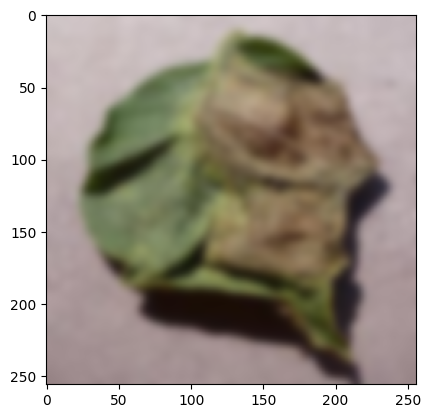

In [50]:
import random
from google.colab.patches import cv2_imshow
import imageio.v3 as iio

for item in os.listdir(new_path + '/train'):
  x = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train/" + item
  for item2 in os.listdir(x):
    rand = random.randint(0,5)
    img = Image.open(x+'/'+item2)

    addr = x+'/'+item2
    print(addr)
    # print(img)
    if rand == 0:
      img = iio.imread(addr)
      mod_img = blur(img)
      plt.imshow(mod_img)
      # cv2.imwrite(addr, mod_img)
      print("blur")
      # mod_img.show()
      print(mod_img.shape)

    elif rand == 1 or rand == 2 or rand == 3 or rand == 4:
      img = cv2.imread(addr)
      mod_img = motion_blur(img)
      cv2.imwrite(addr, mod_img)
      print("Motion blur")
      # cv2_imshow(mod_img)
      print(mod_img.shape)

    else:
      img = cv2.imread(addr)
      mod_img = clipped_zoom(img, 0.5)
      cv2.imwrite(addr, mod_img)
      print("Zoom")
      # cv2_imshow(mod_img)
      print(mod_img.shape)


/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/d0eab616-ab40-476c-ba29-bea7973610f3___Rutg._HL 2445_90deg.JPG
Motion blur
(256, 256, 3)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/8bba78e7-b96d-4c3f-8e36-31f97760bdd0___Rutg._HL 2422_90deg.JPG
Motion blur
(256, 256, 3)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/97052680-ea06-4e00-866a-7ceda1ed1118___Rutg._HL 3656_180deg.JPG
Motion blur
(256, 256, 3)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/33324434-3bb4-406e-a0db-3dafcbdb5bfb___Rutg._HL 3601_180deg.JPG
Motion blur
(256, 256, 3)
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/95f38d4e-5e8d-4b72-ac83-bd7e794a3093___Rutg._HL 2498_180deg.JPG
Motion b

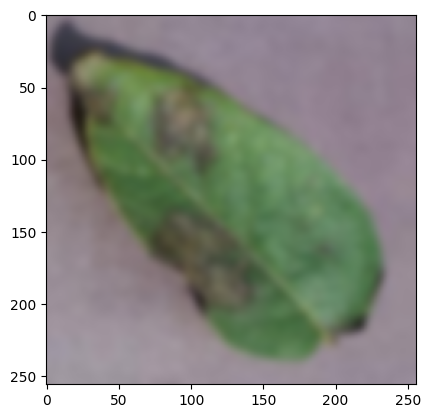

In [51]:
for item in os.listdir(new_path + '/test'):
  x = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/" + item
  for item2 in os.listdir(x):
    rand = random.randint(0,5)
    img = Image.open(x+'/'+item2)

    addr = x+'/'+item2
    print(addr)
    # print(img)
    if rand == 0:
      img = iio.imread(addr)
      mod_img = blur(img)
      plt.imshow(mod_img)
      # cv2.imwrite(addr, mod_img)
      print("blur")
      # mod_img.show()
      print(mod_img.shape)

    elif rand == 1 or rand == 2 or rand == 3 or rand == 4:
      img = cv2.imread(addr)
      mod_img = motion_blur(img)
      cv2.imwrite(addr, mod_img)
      print("Motion blur")
      # cv2_imshow(mod_img)
      print(mod_img.shape)

    else:
      img = cv2.imread(addr)
      mod_img = clipped_zoom(img, 0.5)
      cv2.imwrite(addr, mod_img)
      print("Zoom")
      # cv2_imshow(mod_img)
      print(mod_img.shape)

In [52]:
valid_mod_dir = '/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test'
valid_mod = ImageFolder(valid_mod_dir, transform=transforms.ToTensor()) 

In [53]:
batch_size = 32
valid_mod_dl = DataLoader(valid_mod, batch_size, num_workers=2, pin_memory=True)

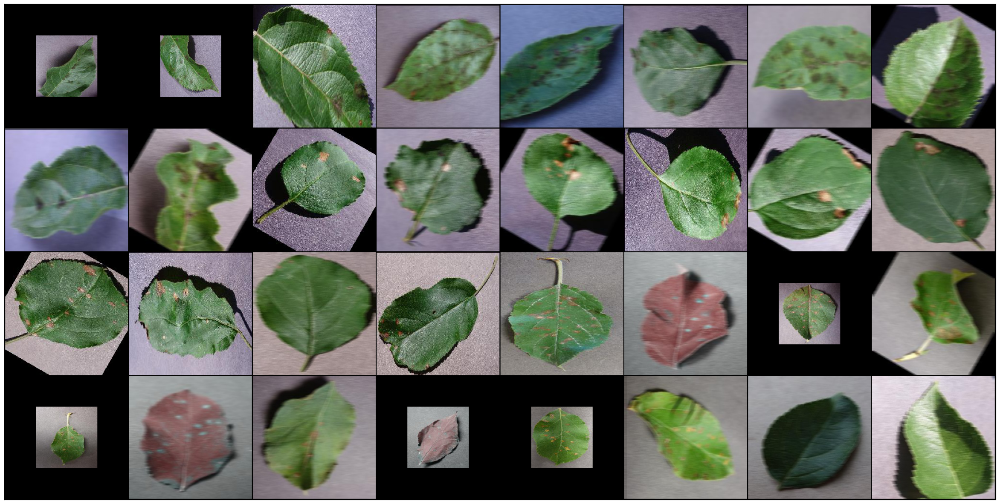

In [54]:
show_batch(valid_mod_dl)

In [55]:
valid_mod_dl = DeviceDataLoader(valid_mod_dl, device)

In [56]:
model = to_device(ResNet9(3, 38), device) 
model

ResNet9(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  )
  (res1): Sequential(
    (0): Sequential(
      (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=Tr

In [57]:
%%time
history = [evaluate(model, valid_mod_dl)]
history

CPU times: user 1.46 s, sys: 201 ms, total: 1.66 s
Wall time: 2.03 s


[{'val_loss': tensor(3.6385, device='cuda:0'), 'val_accuracy': tensor(0.0242)}]

In [58]:
train = ImageFolder(train_dir, transform=transforms.ToTensor())
train_dl = DataLoader(train, batch_size, shuffle=True, num_workers=2, pin_memory=True)
train_dl = DeviceDataLoader(train_dl, device)

In [59]:
epochs = 2
max_lr = 0.01
grad_clip = 0.1
weight_decay = 1e-4
opt_func = torch.optim.Adam

In [65]:
%%time
history += fit_OneCycle(epochs, max_lr, model, train_dl, valid_mod_dl, 
                             grad_clip=grad_clip, 
                             weight_decay=1e-4, 
                             opt_func=opt_func)

Epoch [0], last_lr: 0.00812, train_loss: 0.2553, val_loss: 1.7140, val_acc: 0.6652
Epoch [1], last_lr: 0.00000, train_loss: 0.0906, val_loss: 1.2881, val_acc: 0.7626
CPU times: user 13min 25s, sys: 15min 16s, total: 28min 42s
Wall time: 30min 2s


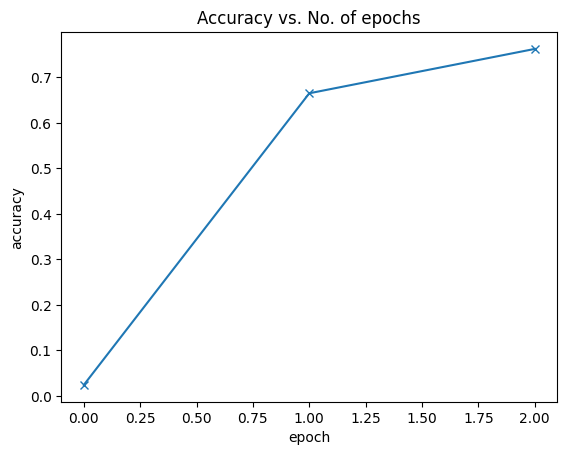

In [66]:
plot_accuracies(history)

### **On using the modified dataset as validation dataset, we get a validation accuracy of 53.16%.**

# **How to make the accuracy improve?**

## **Deblurring the Modified Dataset: Method 1**

In [62]:
def preprocess_images(dataset):
    data_path = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/"
    images = []
    for scene_name in os.listdir(os.path.join(data_path, dataset)):
        scene_path = os.path.join(data_path, dataset, scene_name)
        # blur_path = os.path.join(scene_path, dir)
        image_count = 0
        for image_file in os.listdir(scene_path):
            image_path = os.path.join(scene_path, image_file)
            # Load the image using OpenCV
            image = cv2.imread(image_path)

            # Reshape the images
            img_resized = cv2.resize(image, (224, 224))

            # Normalize the pixel values to [0, 1]
            normalized = img_resized.astype(np.float32) / 255.0
            # Append the preprocessed image to the list
            images.append(normalized)
            image_count += 1
            if image_count >= 10:
                break
    images = np.array(images)
    return images

blur_train_images = preprocess_images("mod_dir/train")
sharp_train_images = preprocess_images("mod_dir_sharp/train")
blur_test_images = preprocess_images("mod_dir/test")
sharp_test_images = preprocess_images("mod_dir_sharp/test")

In [63]:
print("Training Blur Shape", blur_train_images.shape, "Training Sharp Shape", sharp_train_images.shape)
print("Testing Blur Shape", blur_test_images.shape, "Testing Sharp Shape", sharp_test_images.shape)

Training Blur Shape (380, 224, 224, 3) Training Sharp Shape (380, 224, 224, 3)
Testing Blur Shape (380, 224, 224, 3) Testing Sharp Shape (380, 224, 224, 3)


In [68]:
from sklearn.model_selection import train_test_split

x_train, x_val, y_train, y_val = train_test_split(blur_train_images, sharp_train_images, test_size=0.2, random_state=42)
x_train.shape, x_val.shape, y_train.shape, y_val.shape

((304, 224, 224, 3), (76, 224, 224, 3), (304, 224, 224, 3), (76, 224, 224, 3))

Text(0.5, 1.0, 'Sharp Image')

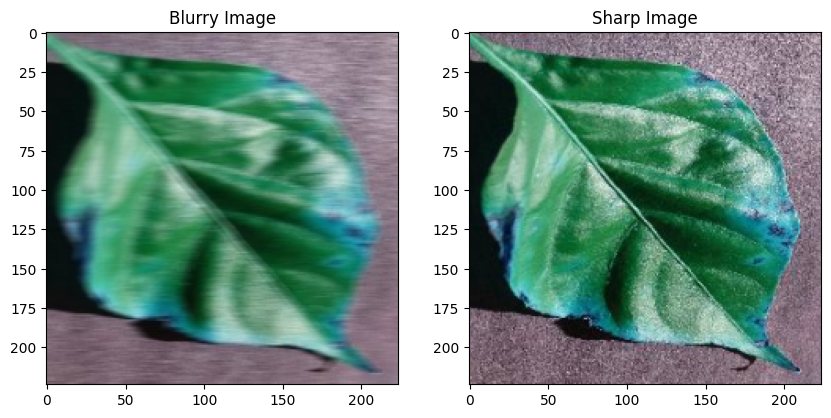

In [69]:
# Visualize the results
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 8))

axes[0].imshow(x_train[0])
axes[0].set_title('Blurry Image')
axes[1].imshow(y_train[0])
axes[1].set_title('Sharp Image')

In [70]:
import tensorflow as tf
from tensorflow.keras import losses, Sequential, Input
from tensorflow.keras.layers import Flatten, Dense, Reshape, Conv2DTranspose, Conv2D, LeakyReLU, BatchNormalization
from tensorflow.keras.datasets import mnist
from tensorflow.keras.models import Model
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

input_shape = (224, 224, 3)
batch_size = 32

In [71]:
autoencoder = Sequential([
    Input(shape=input_shape),
    Conv2D(64, kernel_size=(3, 3), strides=1, padding='same', activation=LeakyReLU()),
    Conv2D(128, kernel_size=(3, 3), padding='same', activation=LeakyReLU()),
    Conv2D(256, kernel_size=(3, 3), strides=1, padding='same', activation=LeakyReLU()),
    BatchNormalization(),
    Conv2DTranspose(256, kernel_size=(3, 3), strides=1, padding='same', activation=LeakyReLU()),
    Conv2DTranspose(128, kernel_size=(3, 3), strides=1, padding='same', activation=LeakyReLU()),
    Conv2DTranspose(64, kernel_size=(3, 3), strides=1, padding='same', activation="relu"),
    Conv2DTranspose(32, kernel_size=(3, 3), strides=1, padding='same', activation="sigmoid"),
    Conv2DTranspose(3, kernel_size=(3, 3), strides=1, padding='same', activation="sigmoid"),
])

# Compile the model
autoencoder.compile(optimizer='adam', loss='mse')

# Print the model summary
autoencoder.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 64)      1792      
                                                                 
 conv2d_1 (Conv2D)           (None, 224, 224, 128)     73856     
                                                                 
 conv2d_2 (Conv2D)           (None, 224, 224, 256)     295168    
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 256)    1024      
 ormalization)                                                   
                                                                 
 conv2d_transpose (Conv2DTra  (None, 224, 224, 256)    590080    
 nspose)                                                         
                                                                 
 conv2d_transpose_1 (Conv2DT  (None, 224, 224, 128)    2

In [72]:
def SSIMLoss(y_true, y_pred):
    return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, 1.0))

def PSNR(y_true, y_pred):
    max_pixel = 1.0
    return (10.0 * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - y_true), axis=-1)))) / 2.303

In [74]:
from keras.callbacks import LearningRateScheduler
from keras import backend as K
from keras.optimizers import Adam

In [79]:
batch_size = 8

In [80]:
from keras.callbacks import ReduceLROnPlateau, ModelCheckpoint

autoencoder.compile(loss='mse', optimizer='adam',metrics=["acc", SSIMLoss, PSNR])
lr_reducer = ReduceLROnPlateau(factor=np.sqrt(0.1),
                               cooldown=0,
                               patience=5,
                               verbose=1)
callbacks = [lr_reducer]
history = autoencoder.fit(x_train,
                      y_train,
                      validation_split=0.2,
                      epochs=40,
                      batch_size=batch_size,
                      callbacks=callbacks)


Epoch 1/40


NotFoundError: ignored

In [ ]:
# blur_images = x_train
# sharp_images = y_train

blur_images = blur_test_images
sharp_images = sharp_test_images


# predict deblurred image
deblurred_images = autoencoder.predict(blur_images)

## **Deblurring the Modified Dataset**

### **Using a State-Of-The-Art deblur model: SelfDeblur**

In [81]:
! git clone https://github.com/ethliup/SelfDeblur.git
%cd ./SelfDeblur/
! pip install -r requirements.txt
%cd ./correlation_package
! python setup.py install
%cd ./reblur_package
! python setup.py install
%cd ..
#put photos in demo/fastec/

Cloning into 'SelfDeblur'...
remote: Enumerating objects: 238, done.
remote: Counting objects: 100% (28/28), done.
remote: Total 238 (delta 27), reused 27 (delta 27), pack-reused 210
Receiving objects: 100% (238/238), 12.68 MiB | 17.74 MiB/s, done.
Resolving deltas: 100% (103/103), done.
/content/SelfDeblur
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
ERROR: Could not find a version that satisfies the requirement meshzoo==0.4.3 (from versions: 0.9.11, 0.9.12, 0.9.13, 0.9.14, 0.9.15, 0.9.17, 0.9.18, 0.9.19, 0.9.20, 0.11.0, 0.11.1)
ERROR: No matching distribution found for meshzoo==0.4.3
/content/SelfDeblur/correlation_package
running install
/usr/lib/python3.10/distutils/cmd.py:62: SetuptoolsDeprecationWarning: setup.py install is deprecated.
!!

        ********************************************************************************
        Please avoid running ``setup.py`` directly.
        Instead, use pypa/build, pypa/installer, 

In [82]:
!bash download_pretrained_models.sh
!bash demo.sh

--2023-04-27 21:31:02--  https://docs.google.com/uc?export=download&id=1VlnQrGMt3gDU4ocTLhIDyndccj30CA1M
Resolving docs.google.com (docs.google.com)... 74.125.23.113, 74.125.23.102, 74.125.23.139, ...
Connecting to docs.google.com (docs.google.com)|74.125.23.113|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-0g-54-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/k4q7ftf920oo1lqit0e7e5tdll8btfj9/1682631000000/04499342872852864355/*/1VlnQrGMt3gDU4ocTLhIDyndccj30CA1M?e=download&uuid=a010faf5-14ba-4418-9c7d-1746bebba054 [following]
--2023-04-27 21:31:05--  https://doc-0g-54-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/k4q7ftf920oo1lqit0e7e5tdll8btfj9/1682631000000/04499342872852864355/*/1VlnQrGMt3gDU4ocTLhIDyndccj30CA1M?e=download&uuid=a010faf5-14ba-4418-9c7d-1746bebba054
Resolving doc-0g-54-docs.googleusercontent.com (doc-0g-54-docs.googleusercontent.com)... 64.233.189.132, 2404:6800:4008

/content/SelfDeblur/experiments/results_demo_fastec/0004_blur.png
/content/SelfDeblur/experiments/results_demo_fastec/0006_blur.png
/content/SelfDeblur/experiments/results_demo_fastec/0000_blur.png
/content/SelfDeblur/experiments/results_demo_fastec/0002_pred.png
/content/SelfDeblur/experiments/results_demo_fastec/0005_pred.png
/content/SelfDeblur/experiments/results_demo_fastec/0005_blur.png
/content/SelfDeblur/experiments/results_demo_fastec/0002_blur.png
/content/SelfDeblur/experiments/results_demo_fastec/0006_pred.png
/content/SelfDeblur/experiments/results_demo_fastec/0001_blur.png
/content/SelfDeblur/experiments/results_demo_fastec/0003_blur.png
/content/SelfDeblur/experiments/results_demo_fastec/0004_pred.png
/content/SelfDeblur/experiments/results_demo_fastec/0003_pred.png
/content/SelfDeblur/experiments/results_demo_fastec/0001_pred.png
/content/SelfDeblur/experiments/results_demo_fastec/0000_pred.png
/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Au

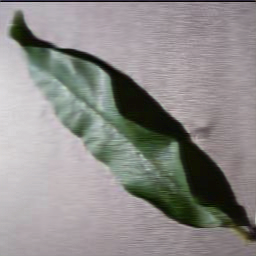

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/8bba78e7-b96d-4c3f-8e36-31f97760bdd0___Rutg._HL 2422_90deg.JPG
/content/SelfDeblur/demo/fastec/d0eab616-ab40-476c-ba29-bea7973610f3___Rutg._HL 2445_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
  

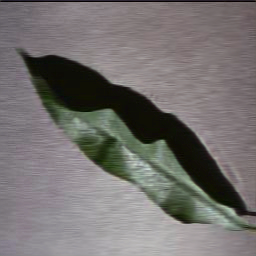

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/97052680-ea06-4e00-866a-7ceda1ed1118___Rutg._HL 3656_180deg.JPG
/content/SelfDeblur/demo/fastec/8bba78e7-b96d-4c3f-8e36-31f97760bdd0___Rutg._HL 2422_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
 

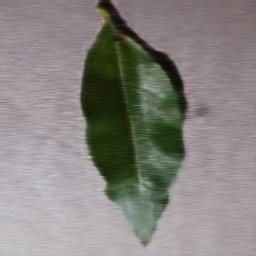

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/33324434-3bb4-406e-a0db-3dafcbdb5bfb___Rutg._HL 3601_180deg.JPG
/content/SelfDeblur/demo/fastec/97052680-ea06-4e00-866a-7ceda1ed1118___Rutg._HL 3656_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(


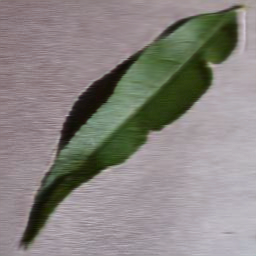

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/95f38d4e-5e8d-4b72-ac83-bd7e794a3093___Rutg._HL 2498_180deg.JPG
/content/SelfDeblur/demo/fastec/33324434-3bb4-406e-a0db-3dafcbdb5bfb___Rutg._HL 3601_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(


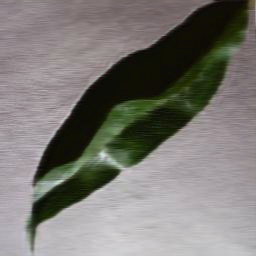

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/fcd5573f-73c7-4cbc-9856-24c858a49ed9___Rutg._HL 3711_180deg.JPG
/content/SelfDeblur/demo/fastec/95f38d4e-5e8d-4b72-ac83-bd7e794a3093___Rutg._HL 2498_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(


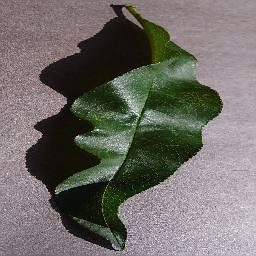

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/a16ae757-2474-428f-a5ef-8985004a77ce___Rutg._HL 3517_180deg.JPG
/content/SelfDeblur/demo/fastec/fcd5573f-73c7-4cbc-9856-24c858a49ed9___Rutg._HL 3711_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(


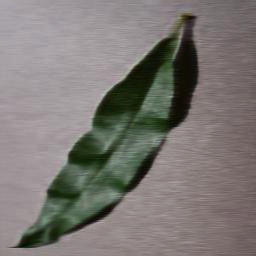

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/24c89fad-d815-438f-b9ab-9c3bee306217___Rutg._HL 3512_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/a16ae757-2474-428f-a5ef-8985004a77ce___Rutg._HL 3517_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet

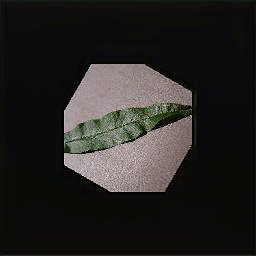

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/6f1c9198-ba96-4a47-95e9-041b623aeb8a___Rutg._HL 2398_90deg.JPG
/content/SelfDeblur/demo/fastec/24c89fad-d815-438f-b9ab-9c3bee306217___Rutg._HL 3512_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_

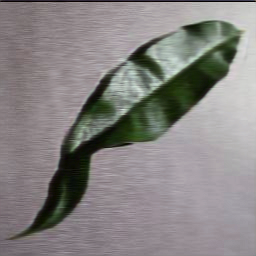

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Peach___healthy/a61c536d-7c39-42dd-9296-c9543f30da91___Rutg._HL 3567.JPG
/content/SelfDeblur/demo/fastec/6f1c9198-ba96-4a47-95e9-041b623aeb8a___Rutg._HL 2398_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        

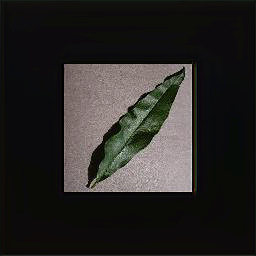

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Raspberry___healthy/cfcc231b-47ae-4adb-9fb2-bdbda4f05113___Mary_HL 9282_90deg.JPG
/content/SelfDeblur/demo/fastec/a61c536d-7c39-42dd-9296-c9543f30da91___Rutg._HL 3567.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
     

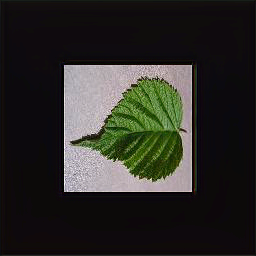

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Raspberry___healthy/5a43ca3a-6454-4339-b9d9-3ad5e3ca8314___Mary_HL 9147_90deg.JPG
/content/SelfDeblur/demo/fastec/cfcc231b-47ae-4adb-9fb2-bdbda4f05113___Mary_HL 9282_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(


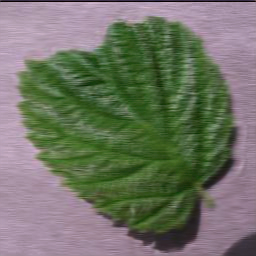

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Raspberry___healthy/b5695141-b666-419c-aad9-602fa6f47737___Mary_HL 6296_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/5a43ca3a-6454-4339-b9d9-3ad5e3ca8314___Mary_HL 9147_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resne

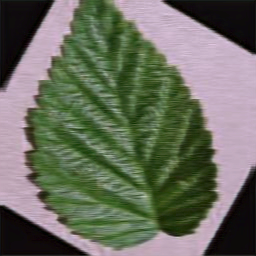

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Raspberry___healthy/894cf725-37b5-498f-beae-d1a9a3e32bac___Mary_HL 6388_180deg.JPG
/content/SelfDeblur/demo/fastec/b5695141-b666-419c-aad9-602fa6f47737___Mary_HL 6296_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resn

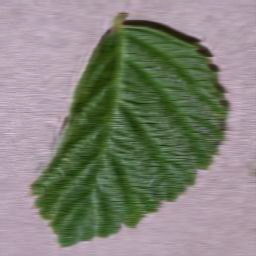

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Raspberry___healthy/df724307-7f4d-4a8a-a86a-24ed790cbc04___Mary_HL 9268_90deg.JPG
/content/SelfDeblur/demo/fastec/894cf725-37b5-498f-beae-d1a9a3e32bac___Mary_HL 6388_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(

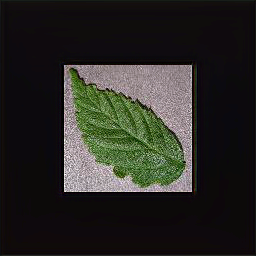

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Raspberry___healthy/3607deb0-405e-4829-b03a-8db6c8b69702___Mary_HL 6354_270deg.JPG
/content/SelfDeblur/demo/fastec/df724307-7f4d-4a8a-a86a-24ed790cbc04___Mary_HL 9268_90deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(

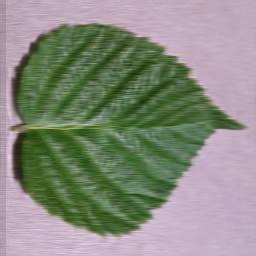

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Raspberry___healthy/f942155e-54d8-4724-a509-92745205d414___Mary_HL 9345.JPG
/content/SelfDeblur/demo/fastec/3607deb0-405e-4829-b03a-8db6c8b69702___Mary_HL 6354_270deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
     

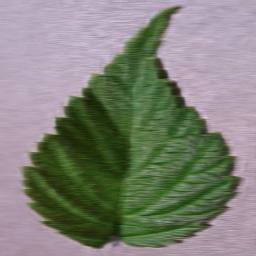

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Raspberry___healthy/733631a5-c883-4e9f-946f-950edc90477a___Mary_HL 6284_180deg.JPG
/content/SelfDeblur/demo/fastec/f942155e-54d8-4724-a509-92745205d414___Mary_HL 9345.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
     

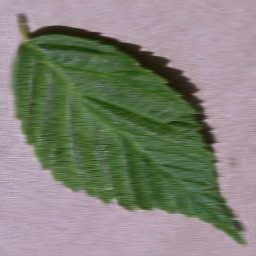

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Raspberry___healthy/174c3316-f010-47bd-aef7-53826f8ec1dc___Mary_HL 6340_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/733631a5-c883-4e9f-946f-950edc90477a___Mary_HL 6284_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resn

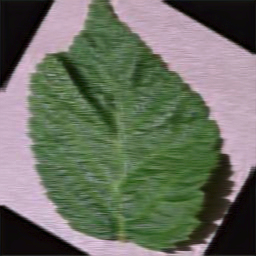

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Raspberry___healthy/04908211-66c9-42f8-a9b1-9d29a686f131___Mary_HL 9175_newPixel25.JPG
/content/SelfDeblur/demo/fastec/174c3316-f010-47bd-aef7-53826f8ec1dc___Mary_HL 6340_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): 

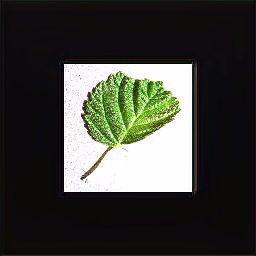

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Blueberry___healthy/1d6c5aa9-4195-4dc9-8965-f84c021a0179___RS_HL 2628.JPG
/content/SelfDeblur/demo/fastec/04908211-66c9-42f8-a9b1-9d29a686f131___Mary_HL 9175_newPixel25.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
   

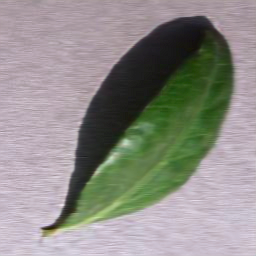

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Blueberry___healthy/6ada5099-804b-4ca5-9e0a-5a39847bd3af___RS_HL 2361.JPG
/content/SelfDeblur/demo/fastec/1d6c5aa9-4195-4dc9-8965-f84c021a0179___RS_HL 2628.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        (conv_bl

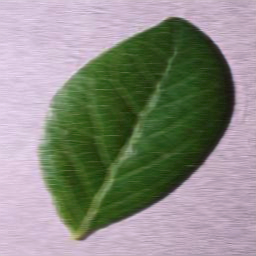

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Blueberry___healthy/3a1f98af-c9c2-4ff2-8772-b329c9c6b0a1___RS_HL 0384_newPixel25.JPG
/content/SelfDeblur/demo/fastec/6ada5099-804b-4ca5-9e0a-5a39847bd3af___RS_HL 2361.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
     

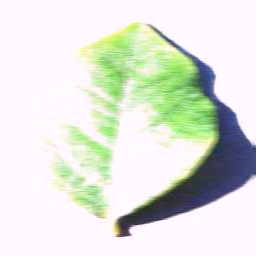

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Blueberry___healthy/b33b60f9-88b9-4fb9-ba39-3dc3c223e3a3___RS_HL 4947.JPG
/content/SelfDeblur/demo/fastec/3a1f98af-c9c2-4ff2-8772-b329c9c6b0a1___RS_HL 0384_newPixel25.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
     

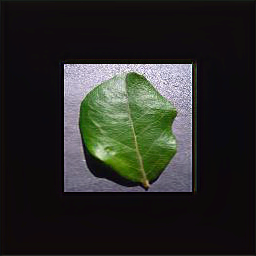

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Blueberry___healthy/4e1bb93b-4eec-473b-a7bc-33b50d6895ed___RS_HL 2504_flipTB.JPG
/content/SelfDeblur/demo/fastec/b33b60f9-88b9-4fb9-ba39-3dc3c223e3a3___RS_HL 4947.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        (

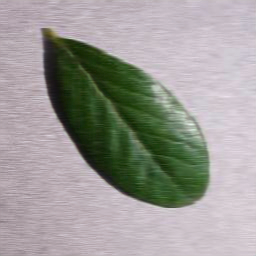

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Blueberry___healthy/bd516d40-9406-4eb3-bfa9-2edf2f3dd606___RS_HL 2313.JPG
/content/SelfDeblur/demo/fastec/4e1bb93b-4eec-473b-a7bc-33b50d6895ed___RS_HL 2504_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        (

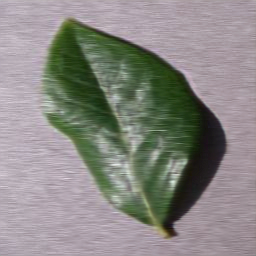

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Blueberry___healthy/4fecc86d-46a1-46c1-a0af-aaf9cacc0355___RS_HL 4982_flipTB.JPG
/content/SelfDeblur/demo/fastec/bd516d40-9406-4eb3-bfa9-2edf2f3dd606___RS_HL 2313.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        (

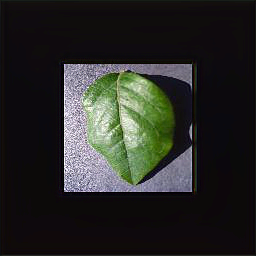

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Blueberry___healthy/04bd89de-3fc5-45c1-acd7-ead9933eb9e3___RS_HL 2428_flipTB.JPG
/content/SelfDeblur/demo/fastec/4fecc86d-46a1-46c1-a0af-aaf9cacc0355___RS_HL 4982_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
  

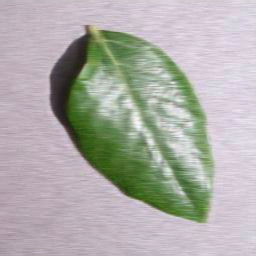

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Blueberry___healthy/57118466-33e2-4d60-9db3-4c0b68c380ce___RS_HL 2448.JPG
/content/SelfDeblur/demo/fastec/04bd89de-3fc5-45c1-acd7-ead9933eb9e3___RS_HL 2428_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        (

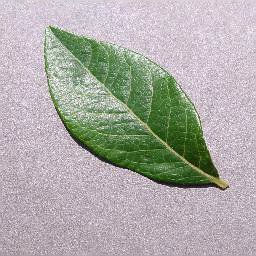

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Blueberry___healthy/94c6876f-4d68-4cc4-a361-75ae56d7a885___RS_HL 0617.JPG
/content/SelfDeblur/demo/fastec/57118466-33e2-4d60-9db3-4c0b68c380ce___RS_HL 2448.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        (conv_bl

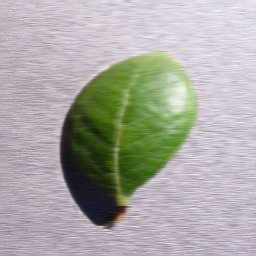

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Cedar_apple_rust/79e57aaf-f825-4818-9594-621327134e0b___FREC_C.Rust 4219_180deg.JPG
/content/SelfDeblur/demo/fastec/94c6876f-4d68-4cc4-a361-75ae56d7a885___RS_HL 0617.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block

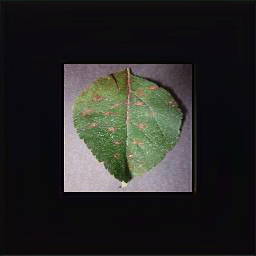

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Cedar_apple_rust/0ce943e7-3fed-41cb-8430-0e0f54ff2bc4___FREC_C.Rust 0014_180deg.JPG
/content/SelfDeblur/demo/fastec/79e57aaf-f825-4818-9594-621327134e0b___FREC_C.Rust 4219_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1):

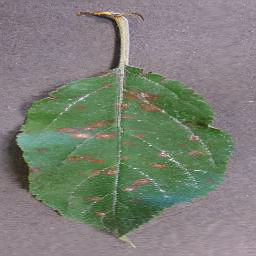

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Cedar_apple_rust/a6ff61c5-74e4-48a5-b3c4-f8a80d3a1eca___FREC_C.Rust 4327_newGRR.JPG
/content/SelfDeblur/demo/fastec/0ce943e7-3fed-41cb-8430-0e0f54ff2bc4___FREC_C.Rust 0014_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1):

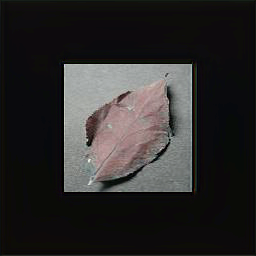

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Cedar_apple_rust/9d03ec86-ab87-4193-8589-9cfeada9fe70___FREC_C.Rust 4442_180deg.JPG
/content/SelfDeblur/demo/fastec/a6ff61c5-74e4-48a5-b3c4-f8a80d3a1eca___FREC_C.Rust 4327_newGRR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1):

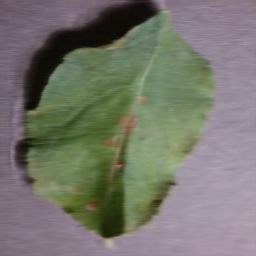

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Cedar_apple_rust/b75430d8-c8a2-4620-9bbb-88c301cba700___FREC_C.Rust 4385_270deg.JPG
/content/SelfDeblur/demo/fastec/9d03ec86-ab87-4193-8589-9cfeada9fe70___FREC_C.Rust 4442_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1):

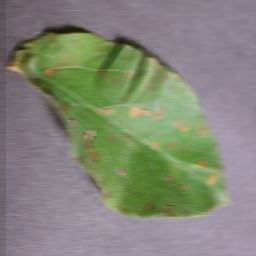

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Cedar_apple_rust/71c08a14-4875-40dc-b35c-8216951ffd8a___FREC_C.Rust 0195_newGRR.JPG
/content/SelfDeblur/demo/fastec/b75430d8-c8a2-4620-9bbb-88c301cba700___FREC_C.Rust 4385_270deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1):

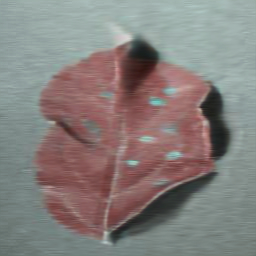

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Cedar_apple_rust/7d3aae9a-3fdd-4b83-b41f-7dd3e0400986___FREC_C.Rust 3616_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/71c08a14-4875-40dc-b35c-8216951ffd8a___FREC_C.Rust 0195_newGRR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
  

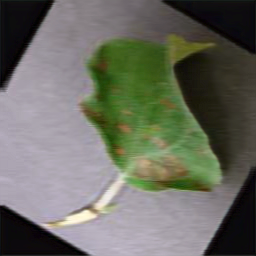

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Cedar_apple_rust/90bff1e0-f71d-4963-93cb-8a9a16f49e74___FREC_C.Rust 9939_newGRR.JPG
/content/SelfDeblur/demo/fastec/7d3aae9a-3fdd-4b83-b41f-7dd3e0400986___FREC_C.Rust 3616_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
  

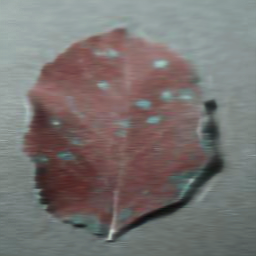

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Cedar_apple_rust/b401cded-e2cb-4907-b475-5373142735d9___FREC_C.Rust 3766_180deg.JPG
/content/SelfDeblur/demo/fastec/90bff1e0-f71d-4963-93cb-8a9a16f49e74___FREC_C.Rust 9939_newGRR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1):

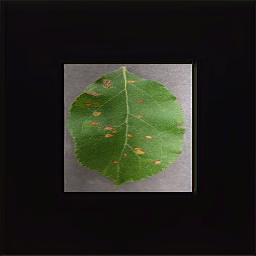

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Apple___Cedar_apple_rust/8817af29-8b64-4fae-be6d-f05a2eed6b85___FREC_C.Rust 3695_180deg.JPG
/content/SelfDeblur/demo/fastec/b401cded-e2cb-4907-b475-5373142735d9___FREC_C.Rust 3766_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1):

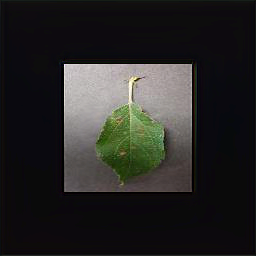

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Late_blight/0605d1be-b99b-408d-bace-e5ba23e72b27___RS_Late.B 5282.JPG
/content/SelfDeblur/demo/fastec/8817af29-8b64-4fae-be6d-f05a2eed6b85___FREC_C.Rust 3695_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block

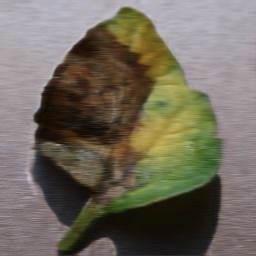

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Late_blight/a5e71962-bf6d-486d-ab54-14004feb76da___RS_Late.B 6088.JPG
/content/SelfDeblur/demo/fastec/0605d1be-b99b-408d-bace-e5ba23e72b27___RS_Late.B 5282.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
       

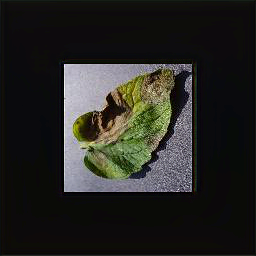

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Late_blight/57c53f65-3137-41d3-9bf7-7ac867f3efe8___RS_Late.B 6255.JPG
/content/SelfDeblur/demo/fastec/a5e71962-bf6d-486d-ab54-14004feb76da___RS_Late.B 6088.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
       

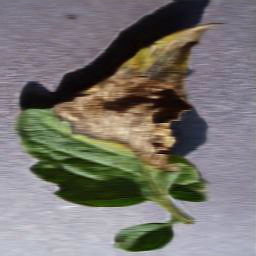

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Late_blight/f27d1b5c-46e2-442f-846d-dd5c6018bb2a___RS_Late.B 6984.JPG
/content/SelfDeblur/demo/fastec/57c53f65-3137-41d3-9bf7-7ac867f3efe8___RS_Late.B 6255.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
       

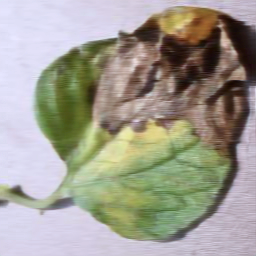

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Late_blight/eda41abe-61cf-439d-9562-e03fee3cd2ca___GHLB2 Leaf 8802.JPG
/content/SelfDeblur/demo/fastec/f27d1b5c-46e2-442f-846d-dd5c6018bb2a___RS_Late.B 6984.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
      

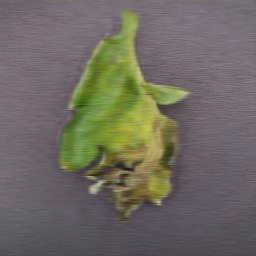

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Late_blight/03f008be-5b97-4827-a2e2-88136b3c8714___RS_Late.B 6290.JPG
/content/SelfDeblur/demo/fastec/eda41abe-61cf-439d-9562-e03fee3cd2ca___GHLB2 Leaf 8802.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
      

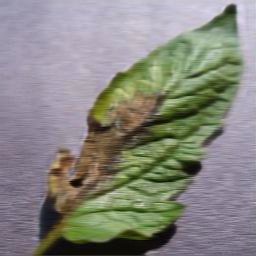

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Late_blight/2f08688f-f6ea-4772-bfa3-5a995e38988c___GHLB2 Leaf 8827.JPG
/content/SelfDeblur/demo/fastec/03f008be-5b97-4827-a2e2-88136b3c8714___RS_Late.B 6290.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
      

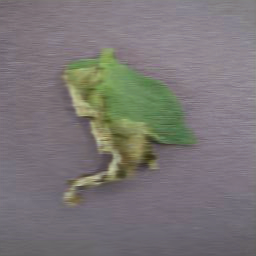

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Late_blight/cb56bd8e-f217-4537-9d35-a62d6b82f48f___GHLB2 Leaf 8769.JPG
/content/SelfDeblur/demo/fastec/2f08688f-f6ea-4772-bfa3-5a995e38988c___GHLB2 Leaf 8827.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
     

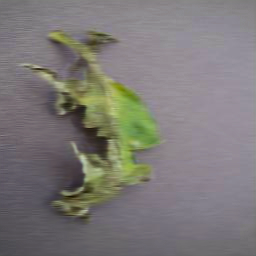

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Late_blight/6815e363-5221-44e2-a5a4-c1b82eb5a4aa___GHLB2 Leaf 9103.JPG
/content/SelfDeblur/demo/fastec/cb56bd8e-f217-4537-9d35-a62d6b82f48f___GHLB2 Leaf 8769.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
     

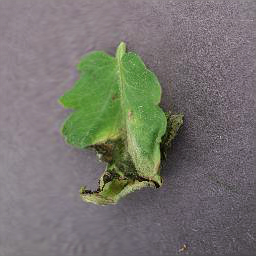

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Late_blight/3f5d6de4-0966-4798-b142-78c4fb4097b5___GHLB2 Leaf 8628_flipLR.JPG
/content/SelfDeblur/demo/fastec/6815e363-5221-44e2-a5a4-c1b82eb5a4aa___GHLB2 Leaf 9103.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block

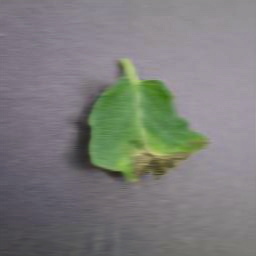

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___healthy/666a5ac6-7394-4465-9e93-7bc29e04ed3b___JR_HL 8134.JPG
/content/SelfDeblur/demo/fastec/3f5d6de4-0966-4798-b142-78c4fb4097b5___GHLB2 Leaf 8628_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
 

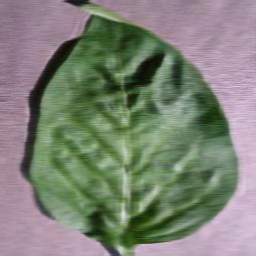

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___healthy/4ebbed7f-321d-45e8-839e-b1af56445be5___JR_HL 6007_newPixel25.JPG
/content/SelfDeblur/demo/fastec/666a5ac6-7394-4465-9e93-7bc29e04ed3b___JR_HL 8134.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
  

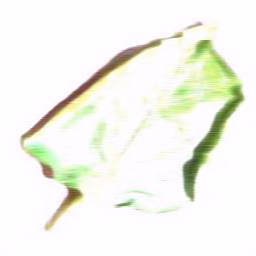

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___healthy/be317686-2513-40b7-932f-e03795b0fbbd___JR_HL 5952.JPG
/content/SelfDeblur/demo/fastec/4ebbed7f-321d-45e8-839e-b1af56445be5___JR_HL 6007_newPixel25.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
  

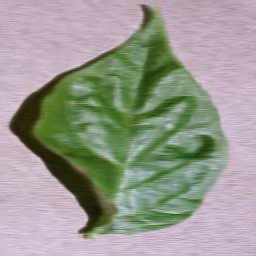

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___healthy/1a93f310-cd75-4af6-96d3-690180b4542a___JR_HL 5850_flipTB.JPG
/content/SelfDeblur/demo/fastec/be317686-2513-40b7-932f-e03795b0fbbd___JR_HL 5952.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
      

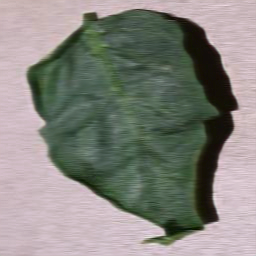

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___healthy/b7103e2b-ef67-441b-b462-be6f0513dee0___JR_HL 8452.JPG
/content/SelfDeblur/demo/fastec/1a93f310-cd75-4af6-96d3-690180b4542a___JR_HL 5850_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
      

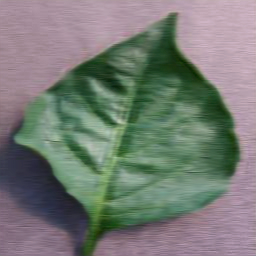

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___healthy/03e8ce3f-9bb5-481c-945b-1fa7d5da09e3___JR_HL 7583_new30degFlipLR.JPG
/content/SelfDeblur/demo/fastec/b7103e2b-ef67-441b-b462-be6f0513dee0___JR_HL 8452.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block

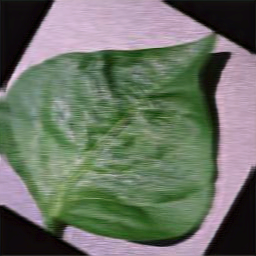

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___healthy/2a5eb7c8-4c8b-43a6-9448-b3983beef06c___JR_HL 8248_newPixel25.JPG
/content/SelfDeblur/demo/fastec/03e8ce3f-9bb5-481c-945b-1fa7d5da09e3___JR_HL 7583_new30degFlipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): R

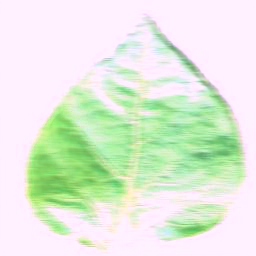

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___healthy/0a3f2927-4410-46a3-bfda-5f4769a5aaf8___JR_HL 8275_180deg.JPG
/content/SelfDeblur/demo/fastec/2a5eb7c8-4c8b-43a6-9448-b3983beef06c___JR_HL 8248_newPixel25.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_bl

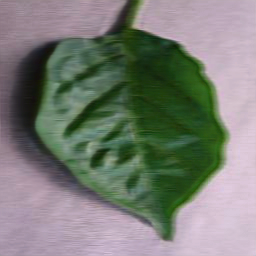

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___healthy/cad06bac-877d-468b-81f4-2e2a60051352___JR_HL 7592.JPG
/content/SelfDeblur/demo/fastec/0a3f2927-4410-46a3-bfda-5f4769a5aaf8___JR_HL 8275_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
      

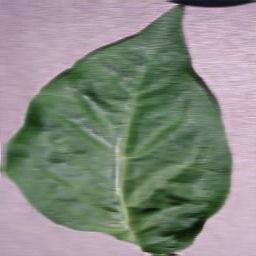

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___healthy/460fc45d-55be-443f-b36d-bcaf8a8bfe6e___JR_HL 8080.JPG
/content/SelfDeblur/demo/fastec/cad06bac-877d-468b-81f4-2e2a60051352___JR_HL 7592.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
        (conv

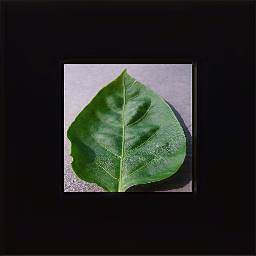

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Leaf_Mold/74fdc5c4-bb48-4774-ba11-cfc7d826e7dc___Crnl_L.Mold 9123_180deg.JPG
/content/SelfDeblur/demo/fastec/460fc45d-55be-443f-b36d-bcaf8a8bfe6e___JR_HL 8080.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
    

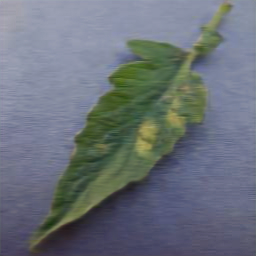

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Leaf_Mold/6685d4bb-ddc5-40b3-b7cf-e4b71a713e31___Crnl_L.Mold 7019_flipTB.JPG
/content/SelfDeblur/demo/fastec/74fdc5c4-bb48-4774-ba11-cfc7d826e7dc___Crnl_L.Mold 9123_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resne

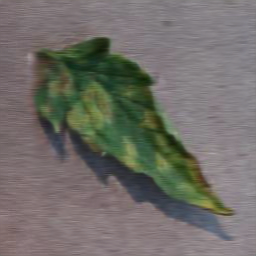

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Leaf_Mold/a6ff3d28-9ffd-4ccd-8283-0d3d0718d311___Crnl_L.Mold 8799_flipTB.JPG
/content/SelfDeblur/demo/fastec/6685d4bb-ddc5-40b3-b7cf-e4b71a713e31___Crnl_L.Mold 7019_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resne

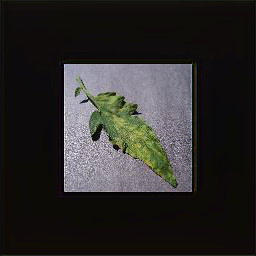

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Leaf_Mold/c05c1b58-b391-41d4-bdd4-72f82b59a508___Crnl_L.Mold 8926.JPG
/content/SelfDeblur/demo/fastec/a6ff3d28-9ffd-4ccd-8283-0d3d0718d311___Crnl_L.Mold 8799_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block

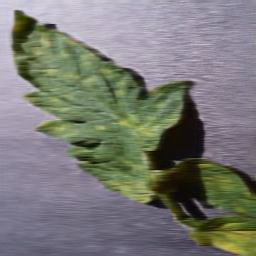

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Leaf_Mold/df78e8cb-8fc5-4682-ab5c-f265b4e8d97e___Crnl_L.Mold 8619.JPG
/content/SelfDeblur/demo/fastec/c05c1b58-b391-41d4-bdd4-72f82b59a508___Crnl_L.Mold 8926.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
     

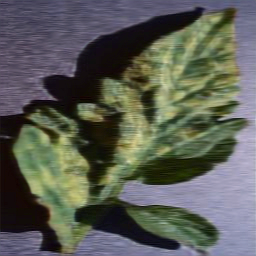

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Leaf_Mold/4176b39b-a3b7-4611-b05b-b4020269bae3___Crnl_L.Mold 7115.JPG
/content/SelfDeblur/demo/fastec/df78e8cb-8fc5-4682-ab5c-f265b4e8d97e___Crnl_L.Mold 8619.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block(
     

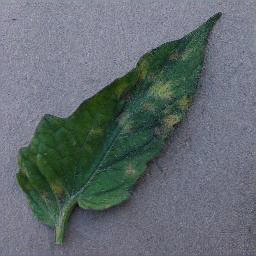

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Leaf_Mold/c661bd24-6fcf-4802-9010-68ef6e2e7fa8___Crnl_L.Mold 6644_180deg.JPG
/content/SelfDeblur/demo/fastec/4176b39b-a3b7-4611-b05b-b4020269bae3___Crnl_L.Mold 7115.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block

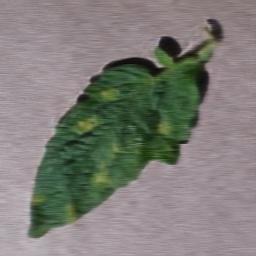

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Leaf_Mold/90d8cc22-bf80-4882-ae80-0a8e02c7ef92___Crnl_L.Mold 6789_flipTB.JPG
/content/SelfDeblur/demo/fastec/c661bd24-6fcf-4802-9010-68ef6e2e7fa8___Crnl_L.Mold 6644_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resne

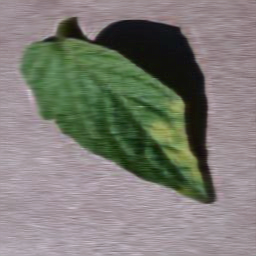

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Leaf_Mold/d2102d1d-e4f2-40d3-84aa-7281e053e646___Crnl_L.Mold 9111.JPG
/content/SelfDeblur/demo/fastec/90d8cc22-bf80-4882-ae80-0a8e02c7ef92___Crnl_L.Mold 6789_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block

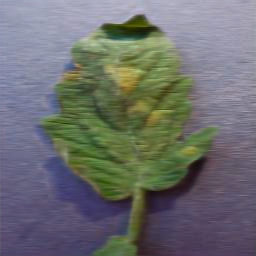

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Tomato___Leaf_Mold/cbcf61e4-9a69-4483-9252-ae649102fb63___Crnl_L.Mold 6858_180deg.JPG
/content/SelfDeblur/demo/fastec/d2102d1d-e4f2-40d3-84aa-7281e053e646___Crnl_L.Mold 9111.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block

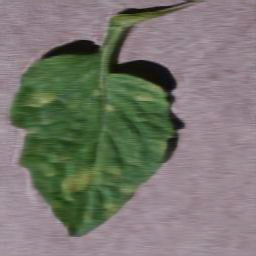

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___Bacterial_spot/97b1492e-13ef-44f3-aa9d-de01444499db___JR_B.Spot 3219_180deg.JPG
/content/SelfDeblur/demo/fastec/cbcf61e4-9a69-4483-9252-ae649102fb63___Crnl_L.Mold 6858_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (

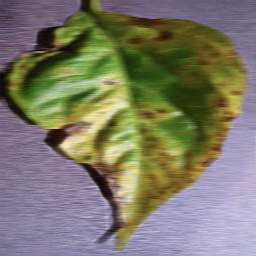

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___Bacterial_spot/a30b2b1d-6dd4-4322-8950-f85c5b946c5a___NREC_B.Spot 9152.JPG
/content/SelfDeblur/demo/fastec/97b1492e-13ef-44f3-aa9d-de01444499db___JR_B.Spot 3219_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Res

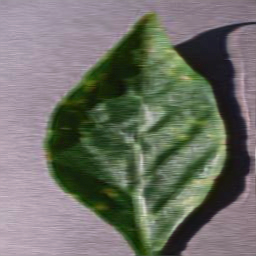

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___Bacterial_spot/7aebe4e4-237e-46b0-9c0d-fc3bd9ba11c3___NREC_B.Spot 9132.JPG
/content/SelfDeblur/demo/fastec/a30b2b1d-6dd4-4322-8950-f85c5b946c5a___NREC_B.Spot 9152.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_b

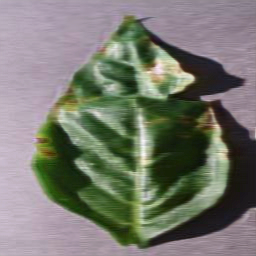

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___Bacterial_spot/0d9b55df-a8c0-4784-b1e4-957c8d679513___NREC_B.Spot 1825.JPG
/content/SelfDeblur/demo/fastec/7aebe4e4-237e-46b0-9c0d-fc3bd9ba11c3___NREC_B.Spot 9132.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_b

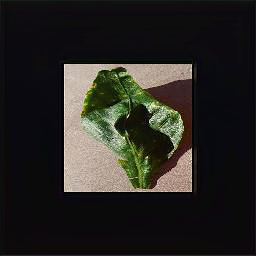

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___Bacterial_spot/f69531dd-6acc-4af1-afb1-b6970e153b6a___NREC_B.Spot 9248_flipTB.JPG
/content/SelfDeblur/demo/fastec/0d9b55df-a8c0-4784-b1e4-957c8d679513___NREC_B.Spot 1825.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): R

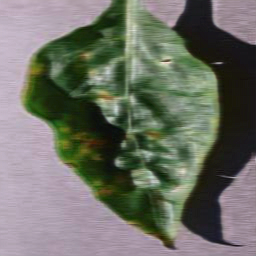

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___Bacterial_spot/12f47cff-1a75-47ec-99d2-01720786e478___NREC_B.Spot 1859.JPG
/content/SelfDeblur/demo/fastec/f69531dd-6acc-4af1-afb1-b6970e153b6a___NREC_B.Spot 9248_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): R

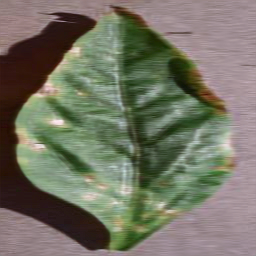

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___Bacterial_spot/e4e7e5a2-5aa1-4378-833d-9142358c7c9b___JR_B.Spot 9092_180deg.JPG
/content/SelfDeblur/demo/fastec/12f47cff-1a75-47ec-99d2-01720786e478___NREC_B.Spot 1859.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Res

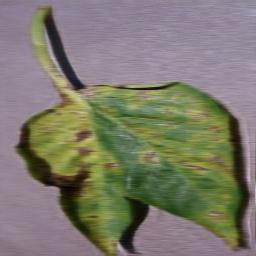

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___Bacterial_spot/8295d0d3-a2b8-4f32-ac02-7e0ee8f75406___NREC_B.Spot 1790.JPG
/content/SelfDeblur/demo/fastec/e4e7e5a2-5aa1-4378-833d-9142358c7c9b___JR_B.Spot 9092_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Res

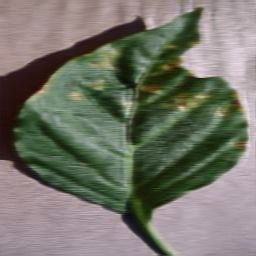

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___Bacterial_spot/b12cadfe-7823-40f6-9c50-87e509c9dcf7___JR_B.Spot 3393_flipTB.JPG
/content/SelfDeblur/demo/fastec/8295d0d3-a2b8-4f32-ac02-7e0ee8f75406___NREC_B.Spot 1790.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Res

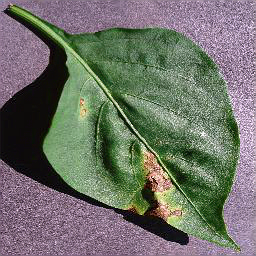

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Pepper,_bell___Bacterial_spot/f3fe3173-1b59-404a-b986-133e847f2090___NREC_B.Spot 9054_flipTB.JPG
/content/SelfDeblur/demo/fastec/b12cadfe-7823-40f6-9c50-87e509c9dcf7___JR_B.Spot 3393_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (

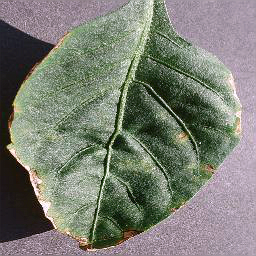

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Potato___Early_blight/9a157bfb-073a-46b2-95c6-16792e30e03f___RS_Early.B 7409.JPG
/content/SelfDeblur/demo/fastec/f3fe3173-1b59-404a-b986-133e847f2090___NREC_B.Spot 9054_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_blo

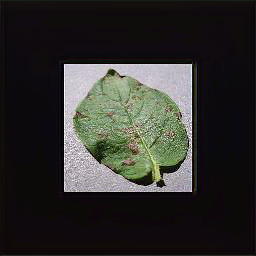

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Potato___Early_blight/cc63b147-ad2a-4bc1-aa05-a07b3c6b7761___RS_Early.B 7091_180deg.JPG
/content/SelfDeblur/demo/fastec/9a157bfb-073a-46b2-95c6-16792e30e03f___RS_Early.B 7409.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_bloc

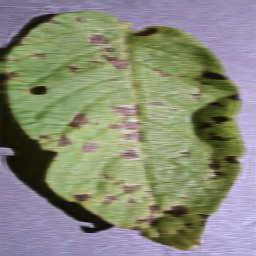

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Potato___Early_blight/811eba3a-112e-43dd-8b22-57f3cde4c504___RS_Early.B 7983_flipTB.JPG
/content/SelfDeblur/demo/fastec/cc63b147-ad2a-4bc1-aa05-a07b3c6b7761___RS_Early.B 7091_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resn

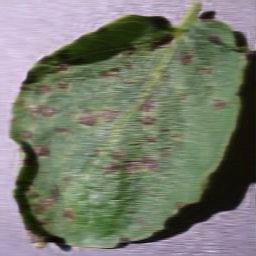

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Potato___Early_blight/31290247-3f4f-445d-8bad-20d7dccbf979___RS_Early.B 7019.JPG
/content/SelfDeblur/demo/fastec/811eba3a-112e-43dd-8b22-57f3cde4c504___RS_Early.B 7983_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_bloc

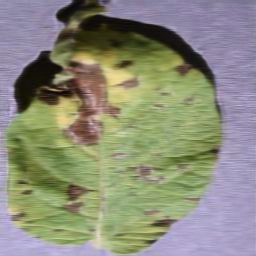

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Potato___Early_blight/779e2b0a-0922-41bc-9393-da3750494671___RS_Early.B 8382_flipTB.JPG
/content/SelfDeblur/demo/fastec/31290247-3f4f-445d-8bad-20d7dccbf979___RS_Early.B 7019.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_bloc

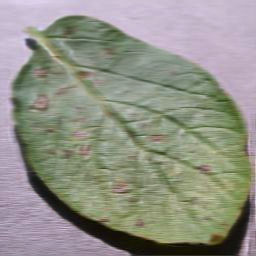

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Potato___Early_blight/aa0ad1ba-f08a-4376-82a1-fec51fbf6810___RS_Early.B 7478.JPG
/content/SelfDeblur/demo/fastec/779e2b0a-0922-41bc-9393-da3750494671___RS_Early.B 8382_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_bloc

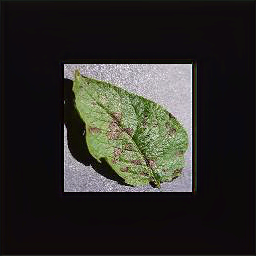

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Potato___Early_blight/98d40b59-5c50-45b6-9b8b-268c40547334___RS_Early.B 8031_180deg.JPG
/content/SelfDeblur/demo/fastec/aa0ad1ba-f08a-4376-82a1-fec51fbf6810___RS_Early.B 7478.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_bloc

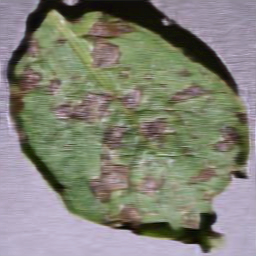

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Potato___Early_blight/d06681cc-3ed1-4af2-ae40-2597eaea3dd4___RS_Early.B 8691_180deg.JPG
/content/SelfDeblur/demo/fastec/98d40b59-5c50-45b6-9b8b-268c40547334___RS_Early.B 8031_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resn

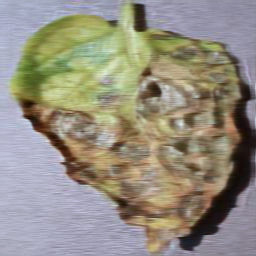

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Potato___Early_blight/bea108c2-bdf1-484d-807c-fa9431f4dc95___RS_Early.B 7265.JPG
/content/SelfDeblur/demo/fastec/d06681cc-3ed1-4af2-ae40-2597eaea3dd4___RS_Early.B 8691_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_bloc

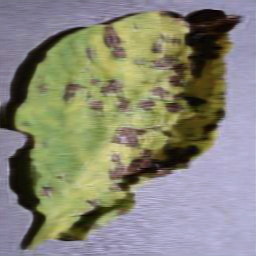

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Potato___Early_blight/d8a55ed1-7b3a-4b25-84b2-6046c0d9e3ab___RS_Early.B 7443_flipTB.JPG
/content/SelfDeblur/demo/fastec/bea108c2-bdf1-484d-807c-fa9431f4dc95___RS_Early.B 7265.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_bloc

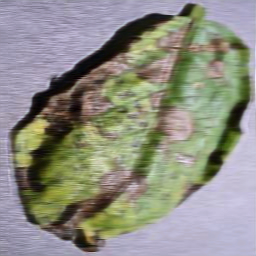

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)/f681ecc4-ed9e-459f-b192-75c3060fac2a___FAM_L.Blight 4986_flipLR.JPG
/content/SelfDeblur/demo/fastec/d8a55ed1-7b3a-4b25-84b2-6046c0d9e3ab___RS_Early.B 7443_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )


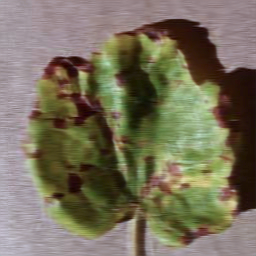

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)/4b45f1a3-1227-4e76-a1a1-7998f1227d08___FAM_L.Blight 1503_flipLR.JPG
/content/SelfDeblur/demo/fastec/f681ecc4-ed9e-459f-b192-75c3060fac2a___FAM_L.Blight 4986_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        

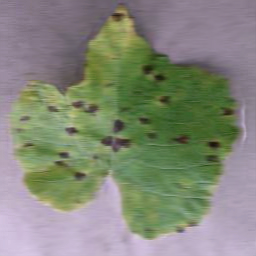

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)/2b82e665-b765-4514-93c9-715a2e452b34___FAM_L.Blight 0791_flipLR.JPG
/content/SelfDeblur/demo/fastec/4b45f1a3-1227-4e76-a1a1-7998f1227d08___FAM_L.Blight 1503_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        

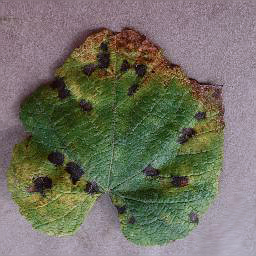

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)/8c555cf5-c6c8-400c-a764-a1b2ed7e66cd___FAM_L.Blight 1576.JPG
/content/SelfDeblur/demo/fastec/2b82e665-b765-4514-93c9-715a2e452b34___FAM_L.Blight 0791_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
     

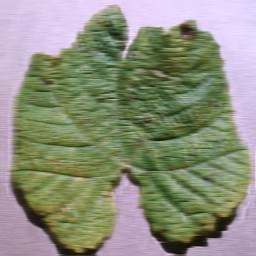

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)/8d7fae08-0885-4226-9ba1-30af99f01107___FAM_L.Blight 4690.JPG
/content/SelfDeblur/demo/fastec/8c555cf5-c6c8-400c-a764-a1b2ed7e66cd___FAM_L.Blight 1576.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
    

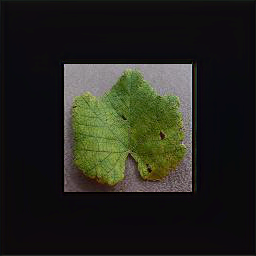

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)/ab0d3eec-a4fa-49ad-a1b3-d7a76ad280a1___FAM_L.Blight 1718_flipLR.JPG
/content/SelfDeblur/demo/fastec/8d7fae08-0885-4226-9ba1-30af99f01107___FAM_L.Blight 4690.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
     

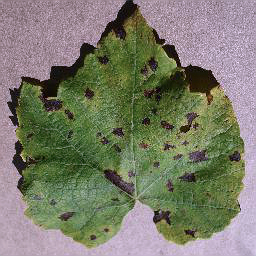

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)/ec3747c3-6cae-48d7-b166-0457d7f6ff26___FAM_L.Blight 4664_flipLR.JPG
/content/SelfDeblur/demo/fastec/ab0d3eec-a4fa-49ad-a1b3-d7a76ad280a1___FAM_L.Blight 1718_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        

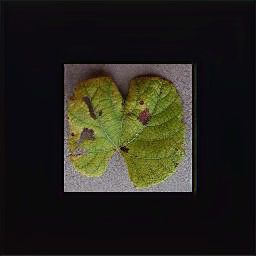

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)/cfcc76d1-21b3-4ba2-935a-79bc9b5bc013___FAM_L.Blight 4913_flipLR.JPG
/content/SelfDeblur/demo/fastec/ec3747c3-6cae-48d7-b166-0457d7f6ff26___FAM_L.Blight 4664_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        

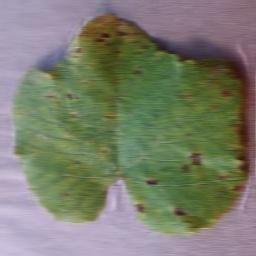

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)/904ad76d-c2c5-43b2-a874-7b80602602d5___FAM_L.Blight 4608.JPG
/content/SelfDeblur/demo/fastec/cfcc76d1-21b3-4ba2-935a-79bc9b5bc013___FAM_L.Blight 4913_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
     

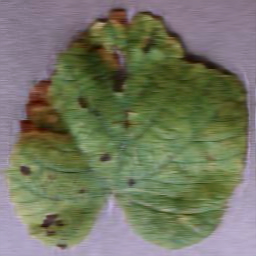

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)/be5bf9f6-5a93-4cec-a7cd-b94c865ecf0c___FAM_L.Blight 4908_flipLR.JPG
/content/SelfDeblur/demo/fastec/904ad76d-c2c5-43b2-a874-7b80602602d5___FAM_L.Blight 4608.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
     

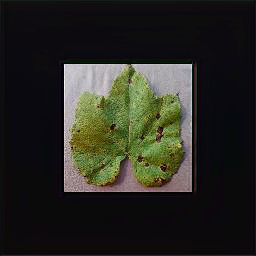

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Northern_Leaf_Blight/f3a574c8-043a-4804-bdba-addb50450720___RS_NLB 3553 copy.jpg
/content/SelfDeblur/demo/fastec/be5bf9f6-5a93-4cec-a7cd-b94c865ecf0c___FAM_L.Blight 4908_flipLR.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
     

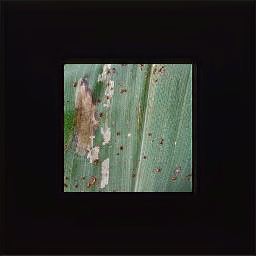

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Northern_Leaf_Blight/ed87978b-71f0-4ab8-b1d3-e7038c0dfa16___RS_NLB 3494_180deg.JPG
/content/SelfDeblur/demo/fastec/f3a574c8-043a-4804-bdba-addb50450720___RS_NLB 3553 copy.jpg
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): 

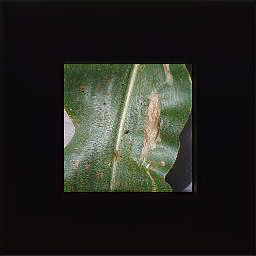

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Northern_Leaf_Blight/8602c5b9-6f3c-455d-8a8a-c80f237395bc___RS_NLB 3659.JPG
/content/SelfDeblur/demo/fastec/ed87978b-71f0-4ab8-b1d3-e7038c0dfa16___RS_NLB 3494_180deg.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resne

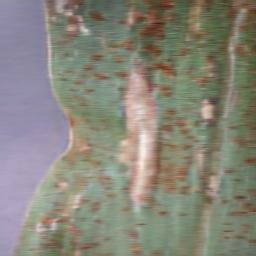

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Northern_Leaf_Blight/8d85e89c-69a7-472a-8a60-9cea0c6e13e8___RS_NLB 3611.JPG
/content/SelfDeblur/demo/fastec/8602c5b9-6f3c-455d-8a8a-c80f237395bc___RS_NLB 3659.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): Resnet_block

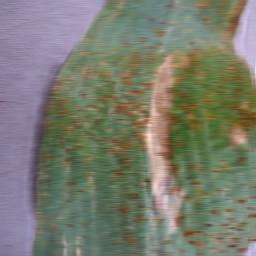

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Northern_Leaf_Blight/9986cb1f-ac94-4f95-b9a1-3815296b66cb___RS_NLB 3806 copy 2_flipTB.jpg
/content/SelfDeblur/demo/fastec/8d85e89c-69a7-472a-8a60-9cea0c6e13e8___RS_NLB 3611.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1)

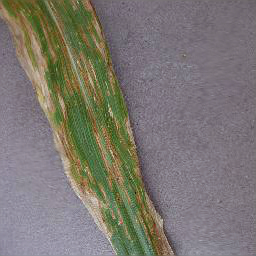

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Northern_Leaf_Blight/cff04564-1693-49ef-b5c0-6bbe4ff92d6b___RS_NLB 3475_flipTB.JPG
/content/SelfDeblur/demo/fastec/9986cb1f-ac94-4f95-b9a1-3815296b66cb___RS_NLB 3806 copy 2_flipTB.jpg
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
  

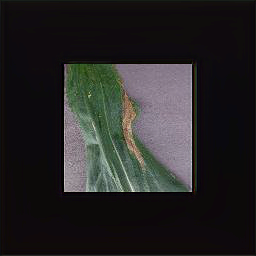

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Northern_Leaf_Blight/845ece89-ec44-4727-b5f4-8df8407b6fea___RS_NLB 4039 copy.jpg
/content/SelfDeblur/demo/fastec/cff04564-1693-49ef-b5c0-6bbe4ff92d6b___RS_NLB 3475_flipTB.JPG
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): 

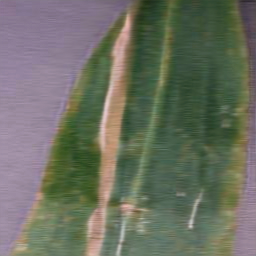

/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test/Corn_(maize)___Northern_Leaf_Blight/59bc212e-6b39-4712-b9c9-6edc3fa3e05f___RS_NLB 3604 copy 2.jpg
/content/SelfDeblur/demo/fastec/845ece89-ec44-4727-b5f4-8df8407b6fea___RS_NLB 4039 copy.jpg
---------- Networks initialized -------------
Deblur_net(
  (en_conv0): Conv2d(
    (net): Sequential(
      (0): Conv2d(3, 32, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): ReLU()
    )
  )
  (en_resB0): Cascaded_resnet_blocks(
    (net): Sequential(
      (0): Resnet_block(
        (conv_block): Sequential(
          (0): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (1): ReLU()
            )
          )
          (1): Conv2d(
            (net): Sequential(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            )
          )
        )
      )
      (1): 

In [ ]:
test_path = '/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test'
import glob

f1 = '/content/SelfDeblur/experiments/results_demo_fastec/*'
files = glob.glob(f1)
for k in files:
  print(k)
  os.remove(k)

for item in os.listdir(test_path):

  x = test_path + '/' + item 
  for item2 in os.listdir(x):
    src = x+ '/' + item2
    print(src)
    exit(0)
    f = '/content/SelfDeblur/demo/fastec/*'
    files = glob.glob(f)
    for k in files:
      print(k)
      os.remove(k)

    img = Image.open(src)
    new_dest = '/content/SelfDeblur/demo/fastec/' + item2
    # new_dest1 = '/content/SelfDeblur/demo/real/' + item2

    img.save(new_dest)
    # # img.save(new_dest1)

    !bash demo.sh
    # # # corrected_img_ = '/content/SelfDeblur/experiments/results_demo_fastec/0' + str(i).zfill(3) + '_pred.png' 
    corrected_img_ = '/content/SelfDeblur/experiments/results_demo_fastec/0000_pred.png'
    corrected_img = Image.open(corrected_img_)
    corrected_img.save(src)
    corrected_img.show()

    f = '/content/SelfDeblur/experiments/results_demo_fastec/*'
    files = glob.glob(f)
    for k in files:
      os.remove(k)

    
    # print("Done with: " + str(i + 1))
    # i = i+1

In [ ]:
new_model = to_device(ResNet9(3, 38), device) 
new_model

In [ ]:
%%time
history = [evaluate(new_model, valid_mod_dl)]
history

In [ ]:
train = ImageFolder(train_dir, transform=transforms.ToTensor())
train_dl = DataLoader(train, batch_size, shuffle=True, num_workers=2, pin_memory=True)
train_dl = DeviceDataLoader(train_dl, device)

In [ ]:
epochs = 2
max_lr = 0.01
grad_clip = 0.1
weight_decay = 1e-4
opt_func = torch.optim.Adam

In [ ]:
%%time
history += fit_OneCycle(epochs, max_lr, new_model, train_dl, valid_mod_dl, 
                             grad_clip=grad_clip, 
                             weight_decay=1e-4, 
                             opt_func=opt_func)

In [ ]:
plot_accuracies(history)

### **On using the de-blurred dataset as validation dataset, we get a validation accuracy of 64.31%.**

## **Method 2: Using a dataset with real life pictures from fields: PlantDoc on our Model**

In [ ]:
# Dataset from : https://github.com/pratikkayal/PlantDoc-Dataset
# Download as given in : https://towardsdatascience.com/an-informative-colab-guide-to-load-image-datasets-from-github-kaggle-and-local-machine-75cae89ffa1e

In [ ]:
import os
os.mkdir('/content/tmp')

In [ ]:
import zipfile

!wget --no-check-certificate \
    "https://github.com/pratikkayal/PlantDoc-Dataset/archive/refs/heads/master.zip" \
    -O "tmp/crops.zip"

zip_ref = zipfile.ZipFile('tmp/crops.zip', 'r') #Opens the zip file in read mode
zip_ref.extractall('tmp') #Extracts the files into the /tmp folder
zip_ref.close()

In [ ]:
data_dir = "/content/tmp/PlantDoc-Dataset-master"
train_dir = data_dir + "/train"
valid_dir = data_dir + "/test"
diseases = os.listdir(train_dir)

In [ ]:
# datasets for validation and training
train = ImageFolder(train_dir, transform=transforms.ToTensor())
valid = ImageFolder(valid_dir, transform=transforms.ToTensor()) 

In [ ]:
model = to_device(ResNet9(3, len(train.classes)), device) 
model

In [ ]:
os.mkdir('/content/tmp/PlantDoc-Dataset-master/mod')
os.mkdir('/content/tmp/PlantDoc-Dataset-master/mod/train')
os.mkdir('/content/tmp/PlantDoc-Dataset-master/mod/test')

In [ ]:
import pathlib
import shutil

def make_image_folders(t):

  path =  '/content/tmp/PlantDoc-Dataset-master/' + t

  for(root, dirs, files) in os.walk(path):
    for item in dirs:
      x = '/content/tmp/PlantDoc-Dataset-master/mod/' + t + '/' + item
      if os.path.exists(x):
        print(item)
      else:
        os.mkdir(x)

In [ ]:
make_image_folders('train')
make_image_folders('test')

In [ ]:
def resize_and_import_images(t):

  path =  '/content/tmp/PlantDoc-Dataset-master/' + t

  for(root, dirs, files) in os.walk(path):

    if root == ("/content/tmp/PlantDoc-Dataset-master/" + t) :
      continue
    src = root
    # it = 0
    for item in os.listdir(src):
      x = pathlib.PurePath(src)
      y = x.name

      dest = "/content/tmp/PlantDoc-Dataset-master/mod/" + t + '/' + y
      # print("To be copied from " + src + "to " + dir_name )

      a = src + '/' + item
      b = dest + '/' + item

      if a.lower().endswith(('jpg', 'jpeg', 'png')):
        try:
          # length = len(a)
          # print(length)
          # if a[length - 7 : length - 4] == "png":
          #   continue

          image = Image.open(a)
          new_image = image.resize((256, 256))
          new_image.save(a)
          shutil.copy( a , b)

        except:
          continue

In [ ]:
resize_and_import_images('train')
resize_and_import_images('test')

In [ ]:
path = train_dir

for(root, dirs, files) in os.walk(path):
  for item in dirs:
    x = "/content/tmp/PlantDoc-Dataset-master/mod/test/" + item
    if os.path.exists(x):
      print(item)
    else:
      os.mkdir(x)

NameError: ignored

In [ ]:
for(root, dirs, files) in os.walk(path):

  if root == "/content/tmp/PlantDoc-Dataset-master/train":
    continue
  src = root
  # it = 0
  for item in os.listdir(src):
    x = pathlib.PurePath(src)
    y = x.name
    dest = "/content/tmp/PlantDoc-Dataset-master/mod/train/" + y
    # print("To be copied from " + src + "to " + dir_name )

    a = src + '/' + item
    b = dest + '/' + item
    # print(a)
    # print(b)

    if a.lower().endswith('jpg'):
      try:
        len = a.length
        # if(a[len - 7 : len - 4] == "png"):
        #   continue
        image = Image.open(a)
        new_image = image.resize((256, 256))
        new_image.save(a)
        shutil.copy( a , b)
      except:
        continue

    # '/content/tmp/PlantDoc-Dataset-master/mod_dir/train/Strawberry leaf/stock-photo-strawberry-leaf-isolated-on-white-background-572055775.jpg'
    # /content/tmp/PlantDoc-Dataset-master/train/Strawberry leaf/stock-photo-strawberry-leaf-isolated-on-the-white-background-255533380.jpg

In [ ]:
path = valid_dir

for(root, dirs, files) in os.walk(path):
  for item in dirs:
    x = "/content/tmp/PlantDoc-Dataset-master/mod/test/" + item
    if os.path.exists(x):
      print(item)
    else:
      os.mkdir(x)

In [ ]:
for(root, dirs, files) in os.walk(path):

  if root == "/content/tmp/PlantDoc-Dataset-master/test":
    continue
  src = root
  # it = 0
  for item in os.listdir(src):
    x = pathlib.PurePath(src)
    y = x.name
    dest = "/content/tmp/PlantDoc-Dataset-master/mod/test/" + y
    # print("To be copied from " + src + "to " + dir_name )

    a = src + '/' + item
    b = dest + '/' + item
    print(a)
    print(b)

    if a.lower().endswith('jpg'):
      try:
        len = a.length
        if(a[len - 7 : len - 4] == "png"):
          continue
        image = Image.open(a)
        new_image = image.resize((256, 256))
        new_image.save(a)
        shutil.copy( a , b)
      except:
        continue

In [ ]:
train_dir = '/content/tmp/PlantDoc-Dataset-master/mod/train'
valid_dir = '/content/tmp/PlantDoc-Dataset-master/mod/test'


train = ImageFolder(train_dir, transform=transforms.ToTensor())
# valid = ImageFolder(valid_dir, transform=transforms.ToTensor()) 

# DataLoaders for training and validation
batch_size = 32
train_dl = DataLoader(train, batch_size, shuffle=True, num_workers=2, pin_memory=True)
# valid_dl = DataLoader(valid, batch_size, num_workers=2, pin_memory=True)

show_batch(train_dl) 

In [ ]:
random_seed = 7
torch.manual_seed(random_seed)

In [ ]:
os.rmdir('/content/tmp/PlantDoc-Dataset-master/mod/test/.ipynb_checkpoints')
valid = ImageFolder(valid_dir, transform=transforms.ToTensor()) 
valid_dl = DataLoader(valid, batch_size, num_workers=2, pin_memory=True)


In [ ]:
# Moving data into GPU
train_dl = DeviceDataLoader(train_dl, device)
valid_dl = DeviceDataLoader(valid_dl, device)

In [ ]:
%%time
history = [evaluate(model, valid_dl)]
history

In [ ]:
epochs = 50
max_lr = 0.01
grad_clip = 0.1
weight_decay = 1e-4
opt_func = torch.optim.Adam

In [ ]:
%%time
history += fit_OneCycle(epochs, max_lr, model, train_dl, valid_dl, 
                             grad_clip=grad_clip, 
                             weight_decay=1e-4, 
                             opt_func=opt_func)

### **Our model gives a validation accuracy of 21.48% on the PlantDoc dataset.**

# **Method 3: Synthesising images from a GAN**

In [ ]:
from __future__ import print_function, division
import sklearn as sk
from keras import backend as K
import matplotlib.gridspec as gridspec
from sklearn.metrics import classification_report
from keras.layers import multiply
from keras.layers import Embedding
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import Reshape
from keras.layers.convolutional import UpSampling2D
from subprocess import check_output

In [ ]:
import numpy as np
import os
import imageio
import pickle
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense
from keras.layers import Flatten
from keras.layers import Activation
from keras.layers import Dropout
from keras.layers import ZeroPadding2D
from keras.layers.convolutional import Conv2D
from keras.layers.pooling import MaxPooling2D
from keras.layers import BatchNormalization
from tensorflow.keras.optimizers import Adam, SGD, RMSprop
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau
# from keras.layers.advanced_activations import LeakyReLU
from keras.layers import ELU, PReLU, LeakyReLU
from keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from skimage.transform import resize as imresize
from tqdm import tqdm
import pandas as pd
from keras import regularizers
from functools import partial
# from keras.layers.merge import _Merge
from keras.layers import add, concatenate

In [ ]:
class RandomWeightedAverage():   ####
    """Provides a (random) weighted average between real and generated image samples"""
    def _merge_function(self, inputs):
        alpha = K.random_uniform((100, 1, 1, 1))
        return (alpha * inputs[0]) + ((1 - alpha) * inputs[1])

In [ ]:
class DCGAN():
    def __init__(self):
        # Input shape
        self.epi=0.22
        self.img_rows = 128
        self.img_cols = 128
        self.channels = 3
        self.img_shape = (self.img_rows, self.img_cols, self.channels)
        self.latent_dim = 1000
        self.num_classes = 38
        def custom_objective(y_true, y_pred):
            epi = self.epi

            # out = -epi+(1-epi)*K.sparse_categorical_crossentropy(y_true, y_pred)
            out = -epi * (K.mean(K.log(y_pred + 0.00000001))) + (1 - epi) * K.sparse_categorical_crossentropy(y_true, y_pred)
            return out
        self.n_critic = 5
        optimizer = RMSprop(lr=0.00005)

        # Build and compile the discriminator
        self.generator = self.build_generator()
        # self.generator.load_weights('generator_weights.hdf5')
        self.critic = self.build_critic()
        # self.critic.load_weights('discriminator_weights.hdf5')
        self.generator.trainable = False
        real_img = Input(shape=self.img_shape)

        # Noise input
        z_disc = Input(shape=(self.latent_dim,))
        label = Input(shape=(1,))
        # Generate image based of noise (fake sample)
        fake_img = self.generator([z_disc,label])

        fake,fake_label = self.critic(fake_img)
        valid, valid_label = self.critic(real_img)

        # Construct weighted average between real and fake images
        interpolated_img = RandomWeightedAverage._merge_function(self,[real_img, fake_img])
        # Determine validity of weighted sample
        validity_interpolated, inter_label = self.critic(interpolated_img)
        partial_gp_loss = partial(self.gradient_penalty_loss,
                          averaged_samples=interpolated_img)
        partial_gp_loss.__name__ = 'gradient_penalty' # Keras requires function names

        self.critic_model = Model(inputs=[real_img, z_disc, label],
                            outputs=[valid, fake, validity_interpolated,valid_label,fake_label])
        self.critic_model.compile(loss=[self.wasserstein_loss,self.wasserstein_loss, partial_gp_loss,custom_objective,custom_objective],
                                        optimizer=optimizer,
                                        loss_weights=[1, 1, 10, 2, 2 ])
        self.critic.trainable = False
        self.generator.trainable = True

        # Sampled noise for input to generator
        z_gen = Input(shape=(self.latent_dim,))
        label_zen=Input(shape=(1,))
        # Generate images based of noise
        img = self.generator([z_gen,label_zen])
        # Discriminator determines validity
        valid,valid_label = self.critic(img)
        # Defines generator model
        self.generator_model = Model([z_gen,label_zen], [valid,valid_label])
        self.generator_model.compile(loss=[self.wasserstein_loss,custom_objective], optimizer=optimizer)


    def gradient_penalty_loss(self, y_true, y_pred, averaged_samples):
        """
        Computes gradient penalty based on prediction and weighted real / fake samples
        """
        gradients = K.gradients(y_pred, averaged_samples)[0]
        # compute the euclidean norm by squaring ...
        gradients_sqr = K.square(gradients)
        #   ... summing over the rows ...
        gradients_sqr_sum = K.sum(gradients_sqr,
                                  axis=np.arange(1, len(gradients_sqr.shape)))
        #   ... and sqrt
        gradient_l2_norm = K.sqrt(gradients_sqr_sum)
        # compute lambda * (1 - ||grad||)^2 still for each single sample
        gradient_penalty = K.square(1 - gradient_l2_norm)
        # return the mean as loss over all the batch samples
        return K.mean(gradient_penalty)


    def wasserstein_loss(self, y_true, y_pred):
        return K.mean(y_true * y_pred)  

    def build_critic(self):
        model = Sequential()
        model.add(Conv2D(16, kernel_size=3, strides=2, input_shape=self.img_shape, padding="same"))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Conv2D(32, kernel_size=3, strides=2, padding="same"))
        model.add(ZeroPadding2D(padding=((0,1),(0,1))))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Conv2D(64, kernel_size=3, strides=2, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Conv2D(128, kernel_size=3, strides=1, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Flatten())
        model.summary()
        img = Input(shape=self.img_shape)
        features = model(img)
        validity = Dense(1, activation="sigmoid")(features)
        label = Dense(self.num_classes + 1, activation="softmax")(features)
        return Model(img, [validity, label])
  
    def build_generator(self):

        model = Sequential()

        model.add(Dense(128 * 8 * 8, activation="relu", input_dim=self.latent_dim))
        model.add(Reshape((8, 8, 128)))
        model.add(UpSampling2D())
        model.add(Conv2D(128, kernel_size=3, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        model.add(UpSampling2D())
        model.add(Conv2D(64, kernel_size=3, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        model.add(UpSampling2D())
        model.add(Conv2D(32, kernel_size=3, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        model.add(UpSampling2D())
        model.add(Conv2D(self.channels, kernel_size=3, padding="same"))
        model.add(Activation("tanh"))
        model.summary()
        noise = Input(shape=(self.latent_dim,))
        label = Input(shape=(1,), dtype='int32')
        label_embedding = Flatten()(Embedding(self.num_classes, self.latent_dim)(label))
        model_input = multiply([noise, label_embedding])
        img = model(model_input)
        return Model([noise, label], img)

    def train(self, epochs, batch_size=128, sample_interval=50):
        # Load the dataset
        X_train, x_valid, y_train, y_valid = self.X_train, self.x_valid, self.y_train, self.y_valid
        y_train = y_train.reshape(-1, 1)
        valid = -np.ones((batch_size, 1))
        fake = np.ones((batch_size, 1))
        dummy = np.zeros((batch_size, 1))
        for epoch in range(epochs):
            for _ in range(self.n_critic):
            # ---------------------
            #  Train Discriminator
            # ---------------------

            # Select a random half of images
                idx = np.random.randint(0, X_train.shape[0], batch_size)
                imgs = X_train[idx]
                img_labels = y_train[idx]
                noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
                sampled_labels =img_labels
                fake_labels = self.num_classes * np.ones(img_labels.shape)
            d_loss = self.critic_model.train_on_batch([imgs, noise, sampled_labels],
                                                      [valid, fake, dummy, sampled_labels,fake_labels])
            g_loss = self.generator_model.train_on_batch([noise,sampled_labels], [valid,sampled_labels])
            print("%d [D loss: %f, acc.: %.2f%%, op_acc: %.2f%%] [G loss: %f]" % (
                epoch, d_loss[0], 100 * d_loss[3], 100 * d_loss[4], g_loss[0]))
            if epoch % sample_interval == 0:
                self.save_model()
                self.sample_images(epoch)

    def sample_images(self, epoch):
        r, c = 10, self.num_classes
        noise = np.random.normal(0, 1, (r * c, self.latent_dim))
        sampled_labels = np.array([num for _ in range(r) for num in range(c)])
        gen_imgs = self.generator.predict([noise, sampled_labels])
        gen_imgs = 0.5 * gen_imgs + 0.5
        fig = plt.figure()
        gs = gridspec.GridSpec(6, 7,
                               wspace=0.0, hspace=0.0)
        cnt = 0
        for i in range(6):
            for j in range(7):
                im=gen_imgs[cnt, :, :, 0:3]
                ax = plt.subplot(gs[i, j])
                ax.imshow(im)
                ax.axis('off')
                cnt += 1
        fig.savefig("%d.png" % epoch)
        plt.close()

    def save_model(self):
        def save(model, model_name):
            model_path = "%s.json" % model_name
            weights_path = "%s_weights.hdf5" % model_name
            options = {"file_arch": model_path,
                       "file_weight": weights_path}
            json_string = model.to_json()
            open(options['file_arch'], 'w').write(json_string)
            model.save_weights(options['file_weight'])

        save(self.generator, "generator")
        save(self.critic, "discriminator")

In [ ]:
acgan = DCGAN()

In [ ]:
def train_model(img,target,a,b,c,d):

    gmodel = ResNet9(3,38)
    # gmodel.summary()
    INPUT_SHAPE = (3, 256, 256)
    print(summary(gmodel.cuda(), (INPUT_SHAPE)))

    if d!=0:
     gmodel.load_weights(filepath='/content/Model/wgan_weights.h5')

    gen = ImageDataGenerator(
        rotation_range=360.,
        width_shift_range=0.3,
        height_shift_range=0.3,
        zoom_range=0.3,
        horizontal_flip=True,
        vertical_flip=True
    )
    # history = gmodel.fit_generator(gen.flow(img, target, batch_size=BATCH_SIZE),
    #                     steps_per_epoch=len(img) / BATCH_SIZE,
    #                      epochs=c,
    #                      verbose=1,
    #                      shuffle=True,
    #                      validation_data=(a, to_categorical(b)))
    # history = gmodel.fit(img, to_categorical(target), batch_size=BATCH_SIZE,
    #                      epochs=c, verbose=1, shuffle=True,
    #                      validation_data=(a, to_categorical(b)))

    max_lr = 0.01
    grad_clip = 0.1
    weight_decay = 0.0001
    opt_func = torch.optim.Adam

    history = fit_OneCycle(epochs=c, max_lr=max_lr, model=gmodel, train_loader=img, val_loader=target, 
                             grad_clip=grad_clip, 
                             weight_decay=weight_decay, 
                             opt_func=opt_func)

    model_json = gmodel.to_json()
    with open("/content/Model/wgan.json", "w") as json_file:
        json_file.write(model_json)
    # serialize weights to HDF5
    gmodel.save_weights("/content/Model/wgan_weights.h5")
    # list all data in history
    print(history.history.keys())

    global MAX,ep,result_max
    if np.max(history.history['val_acc'])>MAX:
        MAX=np.max(history.history['val_acc'])
        y_pred_max = (gmodel.predict(a)).argmax(axis=-1)
        result_max = sk.metrics.confusion_matrix(b,y_pred_max)
        ep=d

    print("hey")

    print((MAX,ep))
    dataframe = pd.DataFrame({'acc': history.history['acc'], 'val_acc': history.history['val_acc']})
    filename="wgan_record"+str(d)+".csv"
    dataframe.to_csv( filename, index=False, sep=',')
    plt.plot(history.history['acc'])
    plt.plot(history.history['val_acc'])
    plt.title('Prediction Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()


In [ ]:
DEFAULT_IMAGE_SIZE = ((128,128))
N_IMAGES = 50
root_dir = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir"
train_dir = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/train"
test_dir = "/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/mod_dir/test"

In [ ]:
from tensorflow.keras.utils import img_to_array

def convert_img_to_arr(image_dir):

  try:
    image = cv2.imread(image_dir)
    if image is not None:
      image = cv2.resize(image, DEFAULT_IMAGE_SIZE)
      return img_to_array(image)
    else:
      return np.array([])
  except Exception as e:
      print(f"Error: {e}")
      return None

In [ ]:
import cv2
import tensorflow as tf

image_list, label_list = [], []

print("Loading Images....")
plant_disease_folders = os.listdir(train_dir)

for folder in plant_disease_folders:
  print(f"Processing {folder}..")
  plant_images = os.listdir(f"{train_dir}/{folder}/")

  for image in plant_images[:N_IMAGES]:
    image_dir = f"{train_dir}/{folder}/{image}"
    if image_dir.endswith(".jpg")==True or image_dir.endswith(".JPG")==True:
      image_list.append(convert_img_to_arr(image_dir))
      label_list.append(folder)

  print("Image loading completed")

np_img_list = np.array(image_list, dtype = np.float16) / 225.0
print()

image_len = len(image_list)
print(f"Total number of images: {image_len}")

In [ ]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer()
img_labels = label_binarizer.fit_transform(label_list)
n_classes = len(label_binarizer.classes_)

print("Total number of classes: ", n_classes)

In [ ]:
x_train, x_valid, y_train, y_valid = train_test_split(np_img_list, img_labels, test_size = 0.2, random_state = 42)
print("original train size",x_train.shape)

r, c = 200, 38

NameError: ignored

In [ ]:
for k in range(1):

    noise = np.random.normal(0, 1, (r * c, 1000)) 
    sampled_labels = np.array([num for _ in range(r) for num in range(c)])
    gen_imgs = acgan.generator.predict([noise, sampled_labels])

    gen_validity, gen_plabels=acgan.critic.predict(gen_imgs)

    gen_imgs=gen_imgs[gen_validity[:,0]>0.5]
    gen_labels=np.asarray(np.argmax(gen_plabels, axis=1))
    gen_labels=gen_labels[gen_validity[:,0]>0.5]

    num_38 =np.sum(gen_labels==38)
    num_total, =gen_labels.shape

    gen_imgs=gen_imgs[gen_labels<38]
    gen_labels = gen_labels[gen_labels<38]

    # # gen_imgs = gen_imgs.resize((256,256,3))

    # _, y_mod = np.where(y_train ==1)


    gen_labels_arr = np.array([])
    gen_labels_arr.resize(gen_labels.shape[0], 38);
    for i in range (gen_labels.shape[0]):
      for j in range (38):
        if (j == gen_labels[i]):
          gen_labels_arr[i][j] = 1;
        else:
          gen_labels_arr[i][j] = 0;
          
    print(gen_labels_arr)

    y_valid = to_categorical(y_valid, 38)
    y_train_reg = np.concatenate((y_train, gen_labels_arr), axis=0)
    x_train_reg = np.concatenate((x_train, gen_imgs), axis=0)

    # for i in range (len(gen_imgs)):
    #   x = gen_plabels[i]
    #   print(x)

    # print("::")

    train_model(x_train_reg, y_train_reg, x_valid, y_valid, 50, k)